### **Contents**

0. Initial Setup
1. Business Problem Understanding
2. Data Understanding
3. Data Preprocessing
4. Modeling
5. Conclusion
6. Recommendation

****

### `Initial Setup`

In [6]:
# Import library eksplorasi dataset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno

import pandas as pd
from geopy.geocoders import Nominatim

# Import library modeling

from sklearn.model_selection import train_test_split, cross_val_score, RandomizedSearchCV, GridSearchCV, KFold
import category_encoders as ce
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# Algoritma
from sklearn.compose import TransformedTargetRegressor
# Tidak Robust Terhadap Outliers 
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor

# Robust terhadap Outliers
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost.sklearn import XGBRegressor




from sklearn.preprocessing import StandardScaler

from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, mean_absolute_percentage_error


import warnings
warnings.filterwarnings('ignore')

### `Business Problem Understanding`

**Latar Belakang**

California adalah salah satu negara bagian yang paling berkembang dan terkenal di Amerika Serikat. Statusnya sebagai pusat teknologi, bisnis, dan hiburan menarik orang-orang untuk tinggal dan bekerja di wilayah ini. Karena itu, permintaan tinggi akan rumah di California menjadi salah satu faktor utama yang mendorong harga rumah menjadi tinggi. Pertumbuhan ekonomi yang berkelanjutan dan lapangan kerja yang kuat di wilayah ini membuat banyak orang mencari rumah, sehingga permintaan yang tinggi meningkatkan nilai properti.

Investasi di sektor real estat merupakan pilihan menarik bagi para investor untuk mencapai keuntungan jangka panjang. Salah satu sumber keuntungan utama bagi investor dalam real estat adalah peningkatan nilai properti dari waktu ke waktu. Potensi kenaikan nilai properti ini memberikan kesempatan bagi investor untuk memperoleh pengembalian investasi yang menguntungkan.

Dalam investasi di bidang real estat, para investor perlu mengidentifikasi dan memahami nilai jual properti dengan baik. Oleh karena itu, dilakukan prediksi harga rumah guna menilai apakah properti tersebut memiliki harga jual yang rasional dan sesuai. Informasi prediksi ini memiliki nilai signifikan bagi para investor dalam menentukan apakah investasi di properti tertentu akan menghasilkan pengembalian investasi yang menguntungkan atau tidak.

Dengan demikian, prediksi harga rumah memiliki peran penting dalam membantu para investor di sektor real estat untuk mengidentifikasi peluang investasi yang menjanjikan dan mencapai hasil yang menguntungkan dari investasi yang mereka lakukan.

**Problem Statement**

Bagaimana melakukan prediksi harga rumah dengan akurat untuk membantu para investor dalam menilai potensi kenaikan nilai properti dan memastikan bahwa investasi yang direncanakan akan memberikan pengembalian investasi yang menguntungkan?

**Goals**

Mengembangkan model prediksi harga rumah yang akurat berdasarkan data historis dan faktor-faktor terkait seperti lokasi, karakteristik properti, dan kondisi ekonomi memiliki potensi untuk memberikan wawasan yang lebih mendalam bagi para investor di sektor real estat. Dengan prediksi harga rumah yang dapat diandalkan, para investor dapat memahami lebih baik tentang potensi kenaikan nilai properti dan membuat keputusan investasi yang lebih bijaksana. Faktor-faktor yang memberikan pengaruh signifikan terhadap harga rumah meliputi Demographics (lokasi properti), Home size and usable space, Age and condition, Distance, Popularity dan serta faktor-faktor ekonomi (pendapatan masyarakat).

Reference:
* RESEARCH ON FACTORS AFFECTING REAL ESTATE VALUES BY DATA MINING\
https://www.researchgate.net/publication/329778823_Research_on_Factors_Affecting_Real_Estate_Values_by_Data_Mining
* Effects of socioeconomic factors on regional housing prices in the USA\
https://www.emerald.com/insight/content/doi/10.1108/IJHMA-11-2012-0056/full/html
* Factors Affecting Housing Prices: International Evidence\
https://websites.ucy.ac.cy/erc/documents/Paper4_87-96.pdf 
* Analysis of factors influencing the price of real estate based on interpretative structural model\
https://www.atlantis-press.com/article/25891072.pdf





**Analytic Approach**

Jadi yang akan kita lakukan adalah menganalisis data historis tentang harga rumah di California untuk menemukan pola-pola yang mempengaruhi kenaikan harga perumahan. Kemudian kita akan membangun model regresi yang dapat membantu dalam memprediksi harga perumahan berdasarkan faktor-faktor yang relevan.

Model Regression memungkinkan kita untuk memodelkan hubungan antara variabel-variabel numerik seperti longitude, latitude, housing_median_age, total_rooms, total_bedrooms, population, households, dan median_income terhadap variabel target "median_house_value." Model regresi akan membantu dalam memahami bagaimana variabel-variabel ini berkontribusi terhadap harga rumah dan memberikan prediksi harga rumah yang akurat berdasarkan nilai-nilai variabel independen yang ada.

Dengan menggunakan metode Machine Learning Regression, para investor dapat memprediksi harga rumah berdasarkan atribut-atribut properti yang relevan. Hal ini akan membantu mereka dalam menilai potensi harga jual dan membuat keputusan investasi yang lebih baik dan berdasarkan analisis data yang lebih informatif.

**Metric Evaluation**

Evaluasi metrik yang akan digunakan adalah MAE, MAPE dan RMSE. Nilai MAE yang lebih rendah menunjukkan bahwa model memiliki kesalahan prediksi yang lebih kecil dan untuk MAPE menunjukan persentase error yang dihasilkan oleh model regresi semakin kecil nilai MAPE maka model semakin akurat dalam memprediksi. Sedangkan untuk RMSE semakin rendah nilai RMSE semakin baik performa model dalam memprediksi harga rumah. maka standar deviasi dari penyimapangan residu semakin rendah

Selain itu, kita juga bisa menggunakan nilai R-squared. Nilai R-squared yang mendekati 1 menunjukkan bahwa model berhasil menjelaskan variasi harga dengan baik (hanya digunakan saat model linier)

### `Data Understanding`

| Columns                                            | Definition                                                   | 
| ------------------------------------------------- | ------------------------------------------------------------ |
| longitude | A measure of how far west a house is; a more negative value is farther west |
| latitude | A measure of how far north a house is; a higher value is farther north |
| housing_median_age | Median age of a house within a block; a lower number is a newer building |
| total_rooms | Total number of rooms within a block |
| total_bedrooms | Total number of bedrooms within a block |
| population | Total number of people residing within a block |
| households | Total number of households, a group of people residing within a home unit, for a block |
| median_income | Median income for households within a block of houses (measured in tens of thousands of US Dollars) |
| median_house_value | 	Median house value for households within a block (measured in US Dollars) |
| ocean_proximity | Location of the house with respect to the ocean/sea |

data yang digunakan sudah bisa menjawab probelm yang dipecahkan. 

File Data : https://drive.google.com/drive/folders/1SlHB6u4ZxUFApx0FVWqALcF9XJC3auVL?usp=drive_link

In [ ]:
data = pd.read_csv("D:\Mas Nabil Data\Clone Data Anak-Anak\Khanza\California-Housing-Price-Prediction-1990-\Data\data_california_house.csv")
pd.set_option("display.max_columns", None)
display(data.head(), data.tail())

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
0,-119.79,36.73,52.0,112.0,28.0,193.0,40.0,1.9750,INLAND,47500.0
1,-122.21,37.77,43.0,1017.0,328.0,836.0,277.0,2.2604,NEAR BAY,100000.0
2,-118.04,33.87,17.0,2358.0,396.0,1387.0,364.0,6.2990,<1H OCEAN,285800.0
3,-118.28,34.06,17.0,2518.0,1196.0,3051.0,1000.0,1.7199,<1H OCEAN,175000.0
4,-119.81,36.73,50.0,772.0,194.0,606.0,167.0,2.2206,INLAND,59200.0


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
14443,-121.26,38.27,20.0,1314.0,229.0,712.0,219.0,4.4125,INLAND,144600.0
14444,-120.89,37.48,27.0,1118.0,195.0,647.0,209.0,2.9135,INLAND,159400.0
14445,-121.90,36.58,31.0,1431.0,NaN,704.0,393.0,3.1977,NEAR OCEAN,289300.0
14446,-117.93,33.62,34.0,2125.0,498.0,1052.0,468.0,5.6315,<1H OCEAN,484600.0
14447,-115.56,32.80,15.0,1171.0,328.0,1024.0,298.0,1.3882,INLAND,69400.0


In [ ]:
import geopandas as gpd
from shapely.geometry import Point

# Ubah DataFrame menjadi GeoDataFrame
# 'Point' mengambil dua argumen: longitude dan latitude
gdf = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.longitude, data.latitude), crs="EPSG:4326")

# data batas-batas county berdasarkan california county bounderies shapefile
counties = gpd.read_file("F:\Capstone-Project-3\Data\CA_Counties\CA_Counties_TIGER2016.shp")

# memastikan data lokasi dan data county memiliki CRS (Coordinate Reference System) yang sama
gdf = gdf.to_crs(counties.crs)

# Gabungkan data
joined = gpd.sjoin(gdf, counties, op='within')

# Ambil hanya kolom df dan kolom 'NAME' dan 'NAMELSAD'
columns_to_keep = data.columns.tolist() + ['NAMELSAD']
df = joined[columns_to_keep]

In [ ]:
df = df.rename(columns={'NAMELSAD': 'County'})

In [ ]:
print(f'Jumlah baris dan kolom: {df.shape}')

pd.DataFrame(
    {
    'feature': df.columns.values,
    'data_type': df.dtypes.values,
    'min': df.min().values,
    'max': df.max().values,
    'n_unique': df.nunique().values,
    'sample_unique': [df[col].unique() for col in df.columns]
    }
)

Jumlah baris dan kolom: (14446, 11)


,feature,data_type,min,max,n_unique,sample_unique
0,longitude,float64,-124.35,-114.31,806,"[-119.79, -119.81, -120.38, -119.83, -119.82, ..."
1,latitude,float64,32.55,41.95,835,"[36.73, 36.76, 36.8, 36.71, 36.81, 36.75, 36.6..."
2,housing_median_age,float64,1.0,52.0,52,"[52.0, 50.0, 12.0, 24.0, 25.0, 39.0, 33.0, 19...."
3,total_rooms,float64,2.0,32627.0,5227,"[112.0, 772.0, 932.0, 3756.0, 1026.0, 3305.0, ..."
4,total_bedrooms,float64,1.0,6445.0,1748,"[28.0, 194.0, 244.0, 681.0, 221.0, 551.0, 563...."
5,population,float64,3.0,35682.0,3498,"[193.0, 606.0, 1043.0, 1586.0, 789.0, 1149.0, ..."
6,households,float64,1.0,6082.0,1649,"[40.0, 167.0, 243.0, 739.0, 183.0, 500.0, 491...."
7,median_income,float64,0.4999,15.0001,9796,"[1.975, 2.2206, 1.4038, 3.8571, 1.5625, 5.0698..."
8,ocean_proximity,object,<1H OCEAN,NEAR OCEAN,5,"[INLAND, NEAR BAY, <1H OCEAN, NEAR OCEAN, ISLAND]"
9,median_house_value,float64,14999.0,500001.0,3548,"[47500.0, 59200.0, 54300.0, 90100.0, 52800.0, ..."


Fixing Values

- Converting Data Type

In [ ]:
# Tentukan kolom-kolom yang ingin diubah tipe datanya
Variabel = ['housing_median_age' , 'total_rooms', 'population', 'households']

# mengubah tipe data menjadi int
df[Variabel] = df[Variabel].astype(int)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14446 entries, 0 to 14355
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           14446 non-null  float64
 1   latitude            14446 non-null  float64
 2   housing_median_age  14446 non-null  int32  
 3   total_rooms         14446 non-null  int32  
 4   total_bedrooms      14309 non-null  float64
 5   population          14446 non-null  int32  
 6   households          14446 non-null  int32  
 7   median_income       14446 non-null  float64
 8   ocean_proximity     14446 non-null  object 
 9   median_house_value  14446 non-null  float64
 10  County              14446 non-null  object 
dtypes: float64(5), int32(4), object(2)
memory usage: 1.1+ MB


__Insight :__
* Dataset Asli terdiri dari 10 kolom dan 14448 baris, tetapi setelah ditambahkan kolom baru menjadi 11 kolom.
* Variabel numerik: longitude, latitude, housing_median_age, total_rooms, total_bedrooms, population, households, median_income, median_house_value
* Variabel categorical: ocean_proximity dan County
* Tipe data sudah disesuaikan, terdapat perubahan tipe data yaitu pada kolom total_rooms, population dan household
* Terdapat missing value pada fitur total_bedrooms sebesar 0.9%
* Fitur "median_house_value" adalah target variabel atau variabel yang ingin diprediksi. Nilai median house value berkisar dari 14,999 hingga 500,001, dan ada sejumlah 3548 nilai unik. Ini menunjukkan bahwa ada variasi besar dalam harga rumah di dataset.

#### **Numerical variable**

In [ ]:
# Statistik deskriptif (data numerik)
df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,14446.000000,14446.000000,14446.000000,14446.000000,14309.000000,14446.000000,14446.000000,14446.000000,14446.000000
mean,-119.566796,35.630077,28.620795,2640.332826,538.288210,1425.240136,499.540911,3.867008,206833.876159
std,2.006613,2.139935,12.596078,2191.696060,423.600432,1149.630385,383.115233,1.891067,115367.628513
min,-124.350000,32.550000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1451.000000,295.000000,784.000000,279.000000,2.571400,119625.000000
50%,-118.490000,34.260000,29.000000,2125.000000,435.000000,1165.000000,410.000000,3.539100,180000.000000
75%,-118.000000,37.710000,37.000000,3148.000000,647.000000,1724.000000,604.000000,4.736100,263900.000000
max,-114.310000,41.950000,52.000000,32627.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


array([[<Axes: title={'center': 'longitude'}>,
        <Axes: title={'center': 'latitude'}>,
        <Axes: title={'center': 'housing_median_age'}>],
       [<Axes: title={'center': 'total_rooms'}>,
        <Axes: title={'center': 'total_bedrooms'}>,
        <Axes: title={'center': 'population'}>],
       [<Axes: title={'center': 'households'}>,
        <Axes: title={'center': 'median_income'}>,
        <Axes: title={'center': 'median_house_value'}>]], dtype=object)

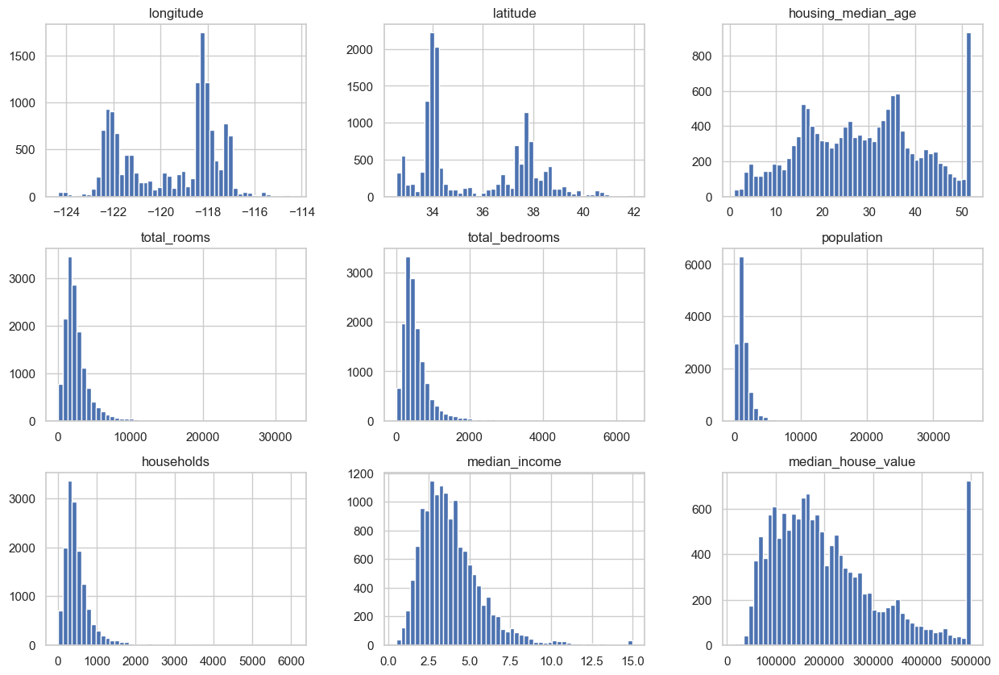

In [ ]:
# Hisogram numerikal
df.hist(bins=50, figsize=(15,10))

__Insight :__
* Distribusi data pada variabel di dataset ini tergolong tidak normal, Pada kolom total_rooms, total_bedrooms, population, households, median_income, dan median_house_value data tergolong distribusi right-skewed (memilki kecondongan ke kanan)
* Pada fitur housing_median_age dan median_house_value memilki outliers yang tergolong datanya banyak.

In [ ]:
numerik_df = df.select_dtypes(include=[np.number])  # hanya kolom numerik
corr = numerik_df.corr(method='pearson')
corr

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.000000,-0.925208,-0.117381,0.057354,0.079579,0.108177,0.064264,-0.009990,-0.045676
latitude,-0.925208,1.000000,0.020738,-0.048542,-0.076828,-0.117656,-0.080049,-0.085205,-0.144112
housing_median_age,-0.117381,0.020738,1.000000,-0.368041,-0.329577,-0.299843,-0.312536,-0.120645,0.103739
total_rooms,0.057354,-0.048542,-0.368041,1.000000,0.931992,0.853466,0.919289,0.199458,0.131919
total_bedrooms,0.079579,-0.076828,-0.329577,0.931992,1.000000,0.874625,0.978563,-0.004246,0.045871
population,0.108177,-0.117656,-0.299843,0.853466,0.874625,1.000000,0.905062,0.006195,-0.026199
households,0.064264,-0.080049,-0.312536,0.919289,0.978563,0.905062,1.000000,0.016259,0.061541
median_income,-0.009990,-0.085205,-0.120645,0.199458,-0.004246,0.006195,0.016259,1.000000,0.693278
median_house_value,-0.045676,-0.144112,0.103739,0.131919,0.045871,-0.026199,0.061541,0.693278,1.000000


- Variabel Median Income memiliki korelasi positif yang cukup kuat dengan Median House Value (sekitar 0.69). Hal ini menunjukkan bahwa semakin tinggi median income suatu wilayah, kemungkinan besar harga rumah median di wilayah tersebut juga cenderung lebih tinggi.
- Variabel housing_median_age memiliki korelasi negatif yang rendah dengan Median House Value, menunjukkan bahwa hubungan usia hunian dengan harga rumah median tidak terlalu kuat.
- Variabel median_income memiliki korelasi negatif yang rendah dengan beberapa variabel lain seperti housing_median_age, population, dan households.
- Total_bedrooms memiliki hubungan kuat dengan total_rooms (nilai korelasi sekitar 0.932) dan households (nilai korelasi sekitar 0.979). Hubungan ini menunjukkan bahwa semakin banyak total kamar tidur di suatu wilayah, kemungkinan besar juga akan terdapat lebih banyak total kamar dan lebih banyak jumlah rumah tangga di wilayah tersebut.


#### **Categorical variable**

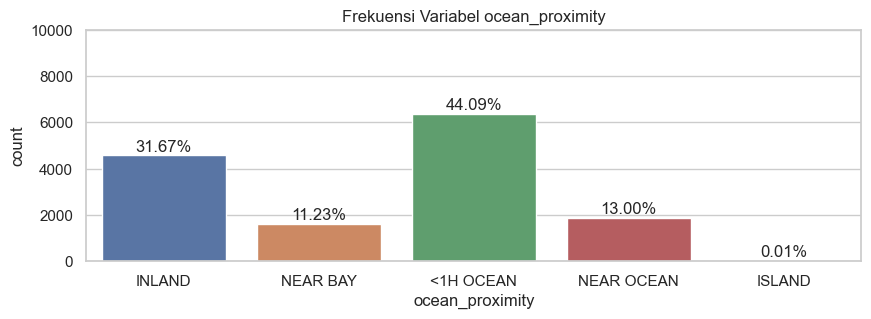

In [ ]:
plt.subplots(figsize=(10, 3))
plt.title("Frekuensi Variabel ocean_proximity")
ax = sns.countplot(data=df, x="ocean_proximity", palette='deep')
ax.set_ylim([0, 10000])

for p in ax.patches:
    percentage = f'{100 * p.get_height() / len(df):.2f}%\n'
    x = p.get_x() + p.get_width() / 2
    y = p.get_height()
    ax.annotate(percentage, (x, y), ha='center', va='center')

plt.show()

In [ ]:
df.ocean_proximity.value_counts()

<1H OCEAN     6369
INLAND        4575
NEAR OCEAN    1878
NEAR BAY      1622
ISLAND           2
Name: ocean_proximity, dtype: int64

__Insight :__
* Grafik menunjukkan distribusi frekuensi dari setiap kategori pada fitur "ocean_proximity". Kategori dengan nilai terbanyak adalah "<1H OCEAN" diikuti oleh "INLAND", "NEAR OCEAN", "NEAR BAY", dan "ISLAND".
* Kategori "<1H OCEAN" memiliki frekuensi tertinggi dan mendominasi distribusi dengan persentase 44.08%. Ini menunjukkan bahwa sebagian besar rumah dalam dataset ini berlokasi di daerah yang dekat dengan laut (<1 jam perjalanan).
* Kategori "ISLAND" memiliki frekuensi terendah dengan persentase sekitar 0.10%. Ini menunjukkan bahwa hanya sedikit rumah yang berlokasi di pulau (island).

In [ ]:
import folium
from sklearn.preprocessing import MinMaxScaler
import matplotlib.colors as mcolors

# Min-Max Scaling pada kolom "population"
scaler = MinMaxScaler()
df['scaled_population'] = scaler.fit_transform(df[['population']])

# Buat peta folium dengan koordinat tengah California
map_california = folium.Map(location=[36.7783, -119.4179], zoom_start=6)

# Buat linear gradient untuk warna berdasarkan rentang nilai dari median_house_value
vmin = df['median_house_value'].min()
vmax = df['median_house_value'].quantile(0.95)
colormap = mcolors.LinearSegmentedColormap.from_list("", ["blue", "red"])

# scatter plot pada peta dengan ukuran circle yang disesuaikan dengan skala populasi
for index, row in df.iterrows():
    folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=row['scaled_population']*20,
                        popup=f"Median House Value: ${row['median_house_value']}",
                        fill_color=colormap((row['median_house_value'] - vmin) / (vmax - vmin)),
                        fill=True, fill_opacity=0.7).add_to(map_california)

# Tampilkan peta
map_california

# ''' iterasi akan menghasilkan baris baru yang ditentukan oleh index dan berisi semua nilai pada baris tersebut dalam objek row.
# Dengan menggunakan row, kita dapat dengan mudah mengakses nilai dari setiap kolom pada baris yang bersangkutan.'''


In [ ]:
# Hapus kolom 'scaled_population' dari DataFrame df
df.drop('scaled_population', axis=1, inplace=True)

__Insight :__
* Persebaran rumah di california paling banyak di kota kota besar di california seperti Los Angeles, San Francisco, San Jose, Sacramento, dan San Diego. Sedangkan, untuk di wilayah selain di kota kota besar tergolong tersebar tidak berpusat pada suatu wilayah.
* Populasi masyarkat yang memilki rumah, terbesar terdapat pada county San Diego dan populasi dengan jumlah yang tergolong besar juga hanya terdapat pada kota kota besar.

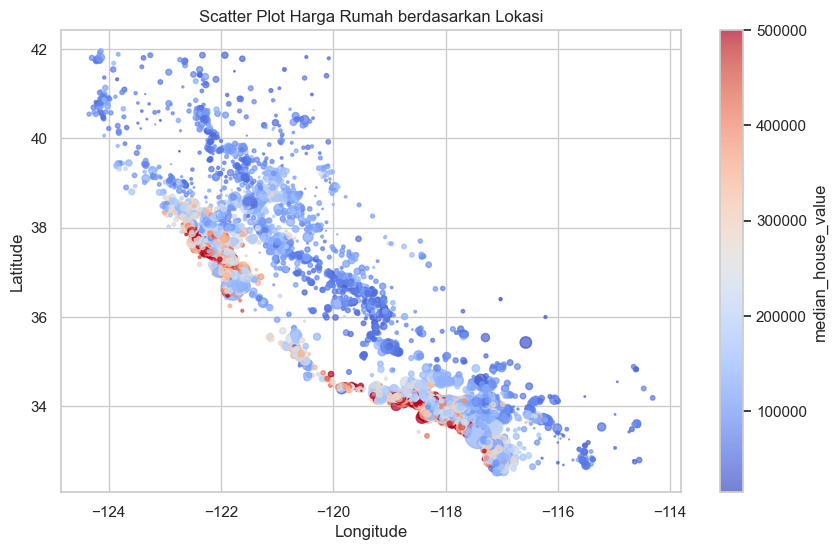

In [ ]:
plt.figure(figsize=(10, 6))  # Atur ukuran gambar
plt.scatter(df.longitude, df.latitude, c=df.median_house_value, cmap='coolwarm', s=df.population/100, alpha=0.7)

#label sumbu dan judul
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Scatter Plot Harga Rumah berdasarkan Lokasi')

#colorbar untuk menggambarkan skala harga Rumah
colorbar = plt.colorbar()
colorbar.set_label('median_house_value')

plt.grid(True)  # Tampilkan grid
plt.show()      # Tampilkan plot

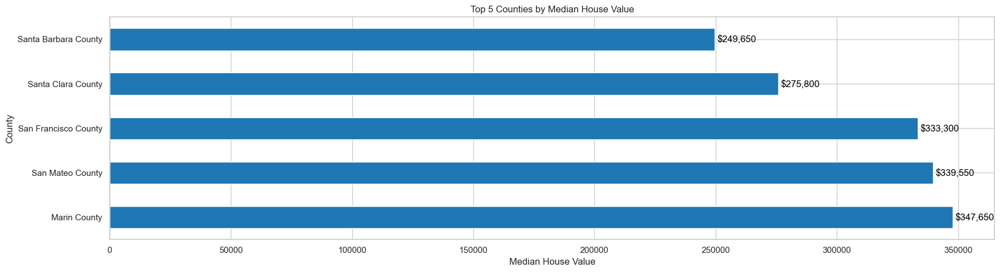

In [ ]:
median_values = df.groupby('County')['median_house_value'].median()
median_values_sorted = median_values.sort_values(ascending=False).head()

plt.figure(figsize=(18, 5))
ax = median_values_sorted.plot(kind='barh')
plt.title('Top 5 Counties by Median House Value')
plt.xlabel('Median House Value')
plt.ylabel('County')

# Menambahkan angka di dalam bar
for i, v in enumerate(median_values_sorted):
    ax.text(v + 1000, i, f"${v:,.0f}", va='center', color='black')

plt.tight_layout()
plt.show()


__Insight :__
* Rumah dengan harga yang tergolong tinggi terdapat pada poin yang berwarna merah yaitu di disekitar kota San Fransisco dan Los Angels dan untuk lokasinya berada di daerah pinggir pantai (Near Ocean).
* County yang memilki harga termahal yaitu pada Marin County, sedangkan Marin County dekat dengan Kota San Francisco

In [ ]:
df_OceanProximity = df.copy()

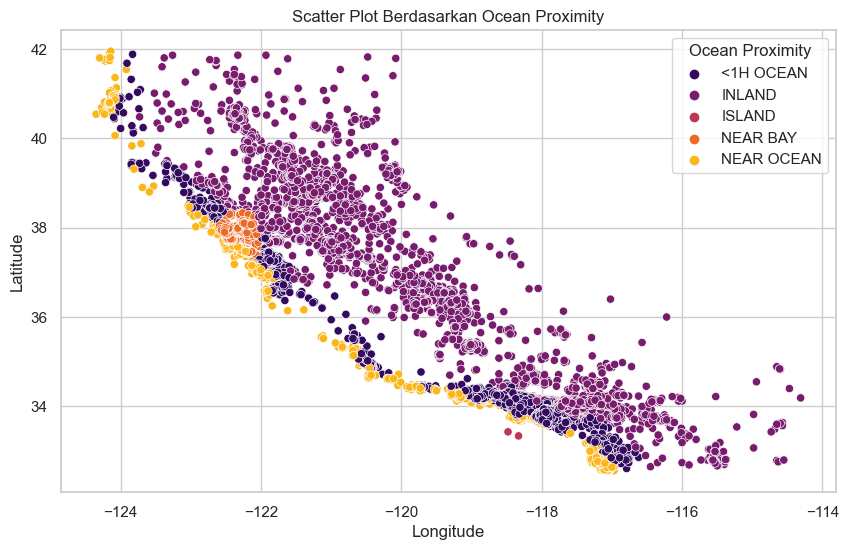

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming df_OceanProximity is a DataFrame containing the unique categories of 'ocean_proximity'
df_OceanProximity['ocean_proximity'] = df_OceanProximity['ocean_proximity'].astype('category')

plt.figure(figsize=(10, 6))  # Atur ukuran gambar
sns.scatterplot(data=df_OceanProximity, x='longitude', y='latitude', hue='ocean_proximity',
                palette='inferno')

# Label sumbu dan judul
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Scatter Plot Berdasarkan Ocean Proximity')

# Tampilkan legend
plt.legend(title='Ocean Proximity')

plt.grid(True)  
plt.show() 


In [ ]:
df.ocean_proximity.value_counts()

<1H OCEAN     6369
INLAND        4575
NEAR OCEAN    1878
NEAR BAY      1622
ISLAND           2
Name: ocean_proximity, dtype: int64

__Insight :__
* Persebaran rumah di California berdasarkan 'ocean_proximity'nya, terlihat bahwa perseberan rumah yang berada di area INLAND lebih tersebar di berbagai wilayah jika dibandingkan dengan ocean proximity lainnya. Tetapi jika dilihat dari banyaknya perumahaan di suatu area, area <1H OCEAN memiliki jumlah perumahaan terbanyak yaitu sebesar 6369.
* Perumahan yang berada diarea ISLAND hanya terdapat 2 perumahan saja.

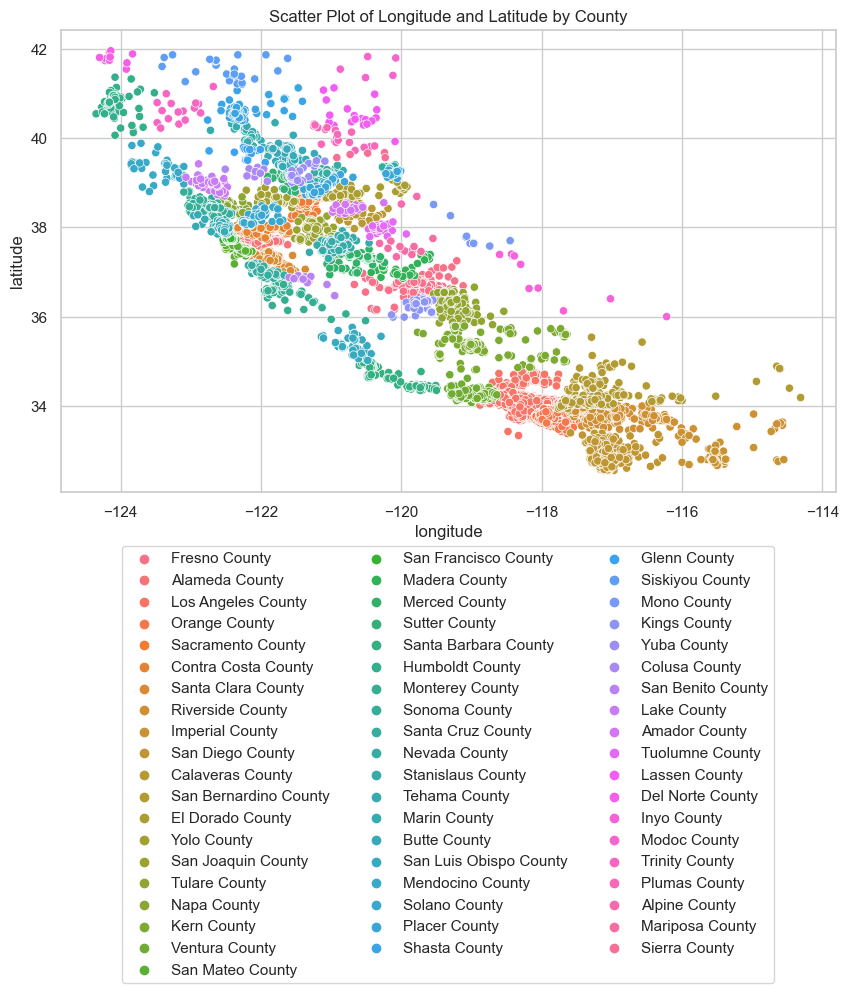

In [ ]:
# Set the color palette to 'tab20'
sns.set_palette('tab20')

plt.figure(figsize=(10, 6))
sns.scatterplot(x='longitude', y='latitude', hue='County', data=df)
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=3)
plt.title('Scatter Plot of Longitude and Latitude by County')
plt.show()


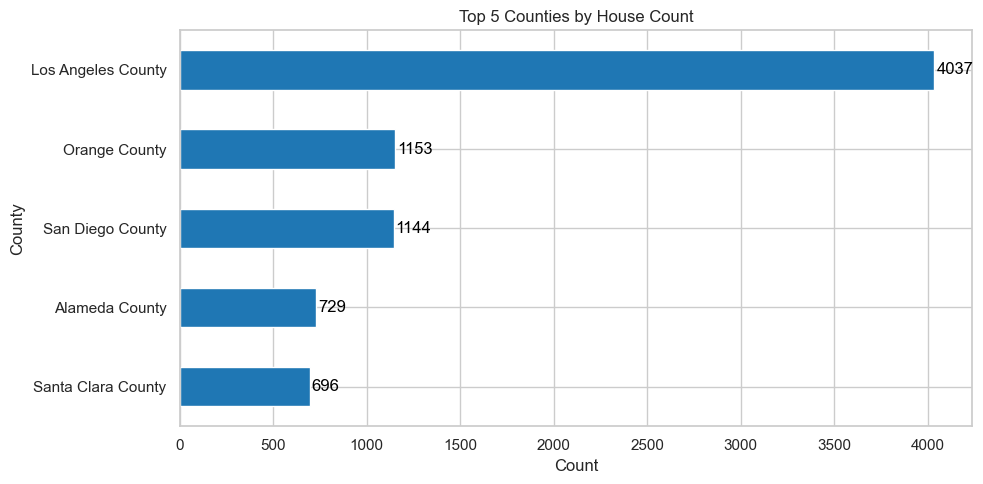

In [ ]:
top_counties = county_counts.head(5)
plt.figure(figsize=(10, 5))
ax = county_counts.sort_values().plot(kind='barh')
plt.title('Top 5 Counties by House Count')
plt.xlabel('Count')
plt.ylabel('County')

# Display counts on each bar
for i, v in enumerate(top_counties.sort_values()):
    ax.text(v + 10, i, str(v), color='black', va='center')

plt.tight_layout()
plt.show()


__Insight :__
* Berdasarkan Scatter Plot of Longitude and Latitude by County dapat melihat persebaran geografis dari data rumah berdasarkan garis bujur (longitude) dan garis lintang (latitude) di California. Setiap titik pada plot mewakili lokasi satu rumah, dan warna titik-titik tersebut diatur berdasarkan nama county di mana rumah tersebut berada. Sehingga dapat diketahui bahwa perumahan yang berada pada wilayah-wilayah dekat dengan kota kota besar memilki tingkat kepadatan yang lebih padat ditandai oleh kumpulan titik-titik yang banyak.
* County yang memilki jumlah perumahan terbanyak yaitu pada Los Angeles County yaitu sebesar 4037.

### `Data Preparation`

In [ ]:
df = df.copy()
df.sample(5)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,County
4419,-121.71,36.88,19,2528,554.0,2332,492,3.7766,<1H OCEAN,177000.0,Monterey County
3865,-118.25,33.97,43,1735,535.0,2288,524,1.9119,<1H OCEAN,98800.0,Los Angeles County
6581,-121.49,38.51,30,3166,607.0,1857,579,3.1768,INLAND,79500.0,Sacramento County
756,-121.80,37.27,10,3301,593.0,2190,575,6.2230,<1H OCEAN,260700.0,Santa Clara County
12961,-120.59,38.76,21,1728,417.0,731,334,1.7266,INLAND,94700.0,El Dorado County


__Insight :__
* Grafik menunjukkan distribusi frekuensi dari setiap kategori pada fitur "ocean_proximity". Kategori dengan nilai terbanyak adalah "<1H OCEAN" diikuti oleh "INLAND", "NEAR OCEAN", "NEAR BAY", dan "ISLAND".
* Kategori "<1H OCEAN" memiliki frekuensi tertinggi dan mendominasi distribusi dengan persentase 44.08%. Ini menunjukkan bahwa sebagian besar rumah dalam dataset ini berlokasi di daerah yang dekat dengan laut (<1 jam perjalanan).
* Kategori "ISLAND" memiliki frekuensi terendah dengan persentase sekitar 0.10%. Ini menunjukkan bahwa hanya sedikit rumah yang berlokasi di pulau (island).

#### **Data Wrangling**

**Duplicat Data**, Tidak ditemukan duplicate data pada dataset ini

In [ ]:
# Cek data duplikat
df.duplicated().sum()

0

**Missing Value**, ditemukan pada variabel `total_bedrooms` yaitu sebesar 0.9%. Selain itu, juga diketahui bahwa pada dataset ini tidak memilki duplicated data

Deteksi dan kuantifikasi missing value:

In [ ]:
print(f'Jumlah baris dan kolom: {df.shape}')

pd.DataFrame(
    {
    'feature': df.columns.values,
    'null_value': df.isna().mean().values * 100,
    }
)

Jumlah baris dan kolom: (14446, 11)


,feature,null_value
0,longitude,0.000000
1,latitude,0.000000
2,housing_median_age,0.000000
3,total_rooms,0.000000
4,total_bedrooms,0.948359
5,population,0.000000
6,households,0.000000
7,median_income,0.000000
8,ocean_proximity,0.000000
9,median_house_value,0.000000


<Axes: >

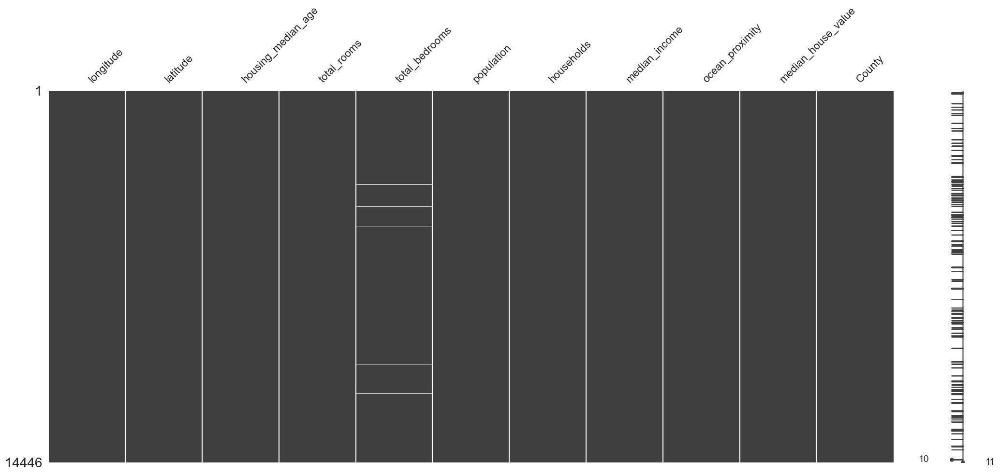

In [ ]:
msno.matrix(df)

__Insight :__ 
* Missing value pada fitur total_bedrooms sebesar 0.9% atau 137 row data.
* Pada data ini pola missing value antar tabel `tidak saling berkaitan` karena letak missing value hanya pada kolom `total_bedrooms`

Handling missing value:

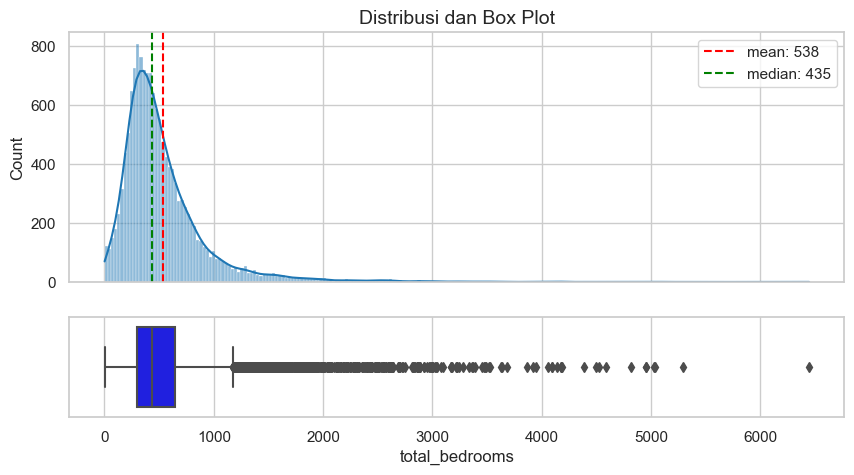

In [ ]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})

# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_bedrooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_bedrooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['total_bedrooms'].mean(), color='red', label=f"mean: {round(df['total_bedrooms'].mean())}", linestyle='--')
ax1.axvline(x=df['total_bedrooms'].median(), color='green', label=f"median: {round(df['total_bedrooms'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('total_bedrooms', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [ ]:
df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,14446.000000,14446.000000,14446.000000,14446.000000,14309.000000,14446.000000,14446.000000,14446.000000,14446.000000
mean,-119.566796,35.630077,28.620795,2640.332826,538.288210,1425.240136,499.540911,3.867008,206833.876159
std,2.006613,2.139935,12.596078,2191.696060,423.600432,1149.630385,383.115233,1.891067,115367.628513
min,-124.350000,32.550000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1451.000000,295.000000,784.000000,279.000000,2.571400,119625.000000
50%,-118.490000,34.260000,29.000000,2125.000000,435.000000,1165.000000,410.000000,3.539100,180000.000000
75%,-118.000000,37.710000,37.000000,3148.000000,647.000000,1724.000000,604.000000,4.736100,263900.000000
max,-114.310000,41.950000,52.000000,32627.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


In [ ]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.total_rooms)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


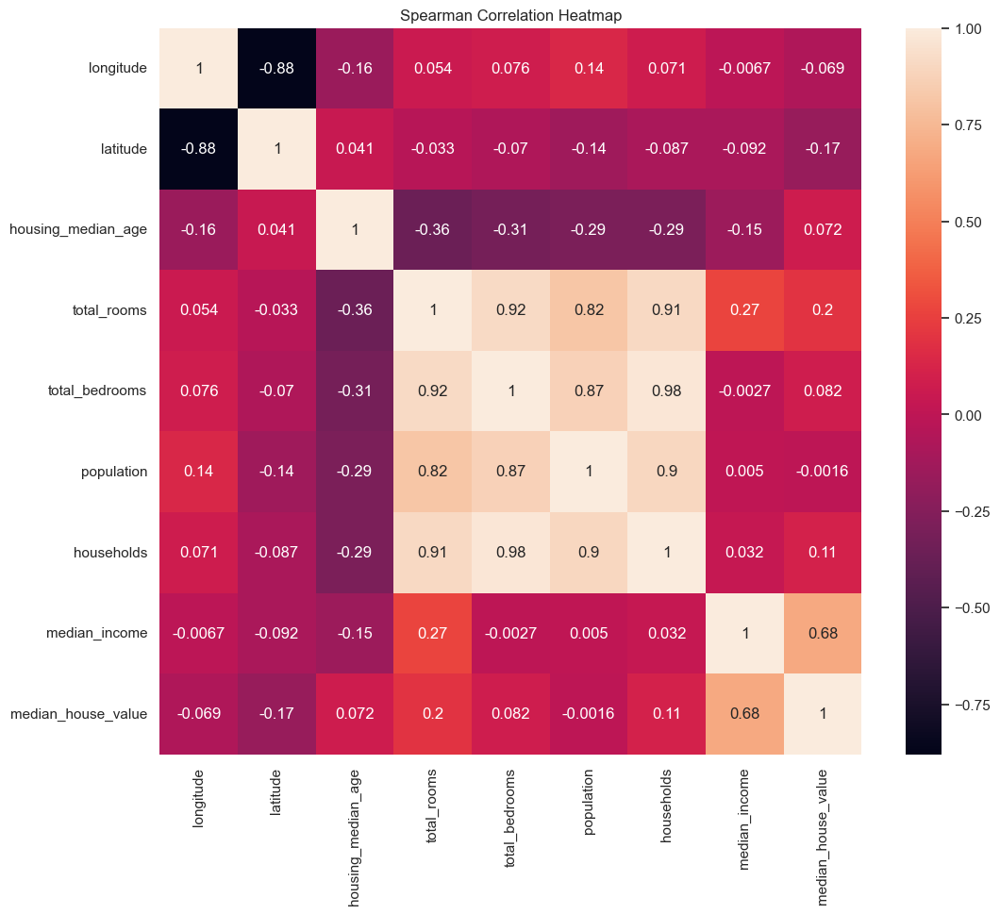

In [ ]:
plt.figure(figsize=(12, 10))
sns.heatmap(df.corr('spearman'), annot=True)
plt.title('Spearman Correlation Heatmap')
plt.show()

__Insight :__ 
* Dari histogram (displot) dapat melihat bahwa distribusi total_bedrooms cenderung miring ke kanan (positively skewed), dengan lebih banyak nilai yang berada di sekitar nilai rendah dan beberapa nilai yang lebih tinggi. Dan setelah dilakukan uji distribusi menggunakan shapiro diketahui bahwa kolom total_bedrooms termasuk kedalam distribusi tidak normal. Sehingga untuk mengisi missing value pada kolom total_bedrooms menggunakan median.
* pada heatmap dapat dilihat terdapat hubungan positif kuat antara jumlah kamar (total_rooms) dan household, yang bisa diartikan bahwa semakin banyak jumlah orang di dalam rumah tangga maka semakin banyak kamar tidur.

**Input Missing Value**\
Inputasi : menggunakan median dengan mengelompokkan data berdasarkan jumlah rumah tangga ('households') dan kemudian menghitung median dari 'total_bedrooms' dalam setiap grup rumah tangga.

Alasan:\
Imputasi missing value dengan menggunakan median dan grup berdasarkan household untuk mempertahankan informasi, menghindari bias, menjaga struktur data, dan memungkinkan analisis yang lebih lengkap.

In [ ]:
# nilai median total_bedrooms berdasarkan households
median_bedrooms = df.groupby(['households'])['total_bedrooms'].median()

# Input missing value pada total_bedrooms berdasarkan households
def fill_missing_bedrooms(row):
    if pd.isnull(row['total_bedrooms']):
        median_value = median_bedrooms.get(row['households'])  
        return median_value
    else:
        return row['total_bedrooms']

# Input missing value pada total_bedrooms
df['total_bedrooms'] = df.apply(fill_missing_bedrooms, axis=1)

# Input nilai NaN dengan mean sebelum melakukan pembulatan
df['total_bedrooms'].fillna(df['total_bedrooms'].median(), inplace=True)

# Melakukan pembulatan
df['total_bedrooms'] = df['total_bedrooms'].round().astype(int)

__Insight :__ 
* Missing value pada fitur total_bedrooms diinput dengan median total_bedrooms yang didasarkan pada households yang sama. Karena total_bedrooms termasuk kedalam distribusi tidak normal (setelah dilakukan uji statistik distribusi) dan total_bedrooms memilki korelasi kuat dengan variabel household.
* Pada value yang dilakukan penginputan dengan pembulatan karena total_bedrooms tidak memungkinkan dengan value desimal.

**Mengecek Distribusi dari total_bedrooms setelah dilakukan inputasi**

Alasan:\
Untuk mengetahui apakah terjadi perubahan distribusi setelah dilakukan inputasi, karena jika terdapat perubahan pada statistik seperti mean, median, dan sebagainya juga akan berubah. Ini dapat mempengaruhi interpretasi dan analisis Anda, terutama jika statistik tersebut digunakan sebagai dasar pengambilan keputusan.

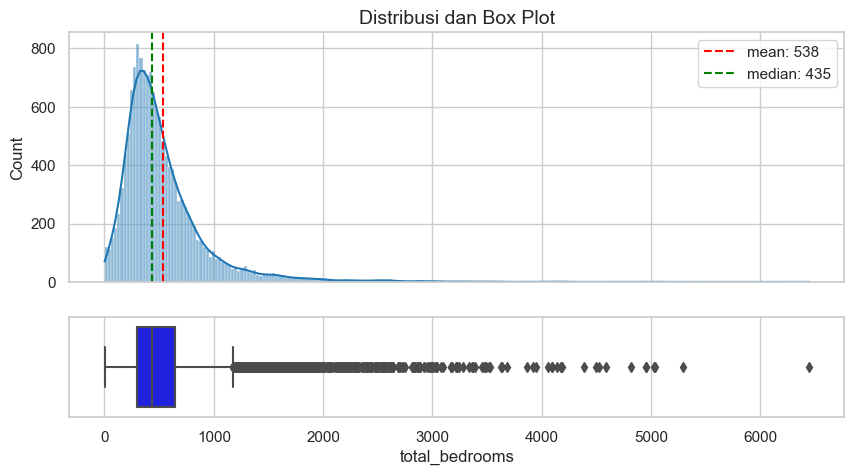

In [ ]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})

# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_bedrooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_bedrooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['total_bedrooms'].mean(), color='red', label=f"mean: {round(df['total_bedrooms'].mean())}", linestyle='--')
ax1.axvline(x=df['total_bedrooms'].median(), color='green', label=f"median: {round(df['total_bedrooms'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('total_bedrooms', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

__Insight :__ 
* Setelah dilakukan inputasi missing value pada kolom total_bedrooms distribusi tidak terdapat perubahan yang signifikan pada statistik seperti mean dan median.

Merubah Tipe Data Total Bedrooms

In [ ]:
# Merubah tipe data total_bedrooms menjadi int
df['total_bedrooms'] = df['total_bedrooms'].astype(int)

**Rare label**, ditemukan pada variabel `ocean_proximity`, terdapat 1 kategori yang jarang mucul atau dibawah batas ambang yaitu pada kategori ISLAND. sedangkan untuk kategori lainnya sudah tergolong dominan. karena jika rare label digunakan dapat menambah noise, menyebabkan over-fitting pada model.

Deteksi dan kuantifikasi rare value:

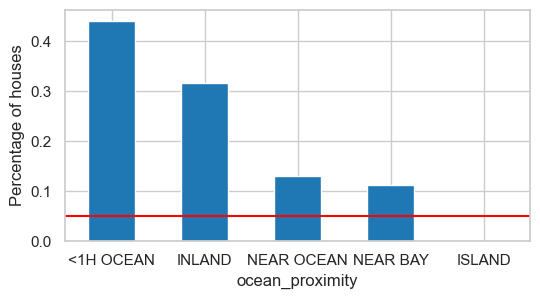

In [ ]:
temp_df = pd.Series(df['ocean_proximity'].value_counts() / len(df))

plt.figure(figsize=(6, 3))
fig = temp_df.sort_values(ascending=False).plot.bar(rot=0)
fig.set_xlabel('ocean_proximity')

fig.axhline(y=0.05, color='red')
fig.set_ylabel('Percentage of houses')
plt.show()

In [ ]:
df.ocean_proximity.value_counts()

<1H OCEAN     6369
INLAND        4575
NEAR OCEAN    1878
NEAR BAY      1622
ISLAND           2
Name: ocean_proximity, dtype: int64

__Insight :__ 
* Mayoritas rumah dalam dataset terletak di daerah 'INLAND' dan '<1H OCEAN'.
* Proporsi rumah di daerah 'ISLAND' sangat rendah.
* Kategori 'NEAR BAY' memiliki proporsi yang cukup besar, tetapi tidak sebesar 'INLAND' atau '<1H OCEAN'.

**Handling Rare Label**

Alasan:\
Handling terhadap rare label dapat mengurangi dampak negatif yang disebabkan oleh label langka dan membantu model mempelajari pola yang lebih umum dan informatif dalam variabel 'ocean_proximity'. Ini dapat meningkatkan kinerja dan stabilitas model Anda.

Kelompokkan ulang variabel kategorikal `ocean_proximity` menjadi 3 kategori yaitu <1H Ocean, NEAR OCEAN dan NEAR BAY

In [ ]:
df_filter = df[df.ocean_proximity == 'NEAR OCEAN']
df_filter.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,1878.000000,1878.000000,1878.000000,1878.000000,1878.000000,1878.000000,1878.000000,1878.000000,1878.000000
mean,-119.338765,34.758040,29.362620,2623.264111,541.379659,1365.956869,505.648030,4.015629,249872.442492
std,2.343943,2.305262,11.890059,2063.996560,382.271113,1025.847548,353.609435,1.976171,123052.043976
min,-124.350000,32.550000,2.000000,15.000000,3.000000,8.000000,3.000000,0.643300,37500.000000
25%,-122.030000,32.780000,20.000000,1505.750000,311.000000,784.000000,296.250000,2.634250,150075.000000
50%,-118.245000,33.790000,29.000000,2197.000000,465.500000,1135.500000,433.000000,3.682700,228750.000000
75%,-117.180000,36.990000,37.000000,3148.250000,667.750000,1620.750000,616.500000,4.903300,325975.000000
max,-116.970000,41.950000,52.000000,30405.000000,4585.000000,12873.000000,4176.000000,15.000100,500001.000000


In [ ]:
df_filter1 = df[df.ocean_proximity == 'NEAR BAY']
df_filter1.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,1622.000000,1622.000000,1622.000000,1622.000000,1622.000000,1622.000000,1622.000000,1622.000000,1622.000000
mean,-122.259679,37.803181,37.655980,2452.847719,506.860666,1208.284217,479.975339,4.179790,258512.974723
std,0.146658,0.185480,13.161926,1769.438069,361.020880,847.402585,337.545445,2.034724,123794.049463
min,-122.590000,37.350000,2.000000,8.000000,1.000000,8.000000,1.000000,0.499900,22500.000000
25%,-122.400000,37.730000,28.250000,1416.250000,284.000000,709.500000,272.000000,2.823625,162500.000000
50%,-122.250000,37.790000,39.000000,2079.500000,419.000000,1029.000000,401.500000,3.819200,230800.000000
75%,-122.140000,37.910000,52.000000,3011.250000,623.000000,1481.000000,590.000000,5.045850,347475.000000
max,-122.010000,38.340000,52.000000,18634.000000,3226.000000,8117.000000,3052.000000,15.000100,500001.000000


In [ ]:
df_filter2 = df[df.ocean_proximity == 'ISLAND']
df_filter2.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,2.000000,2.00000,2.000000,2.000000,2.000000,2.000000,2.00000,2.000000,2.000000
mean,-118.405000,33.38500,40.500000,1537.500000,402.500000,761.000000,302.00000,2.718750,351100.000000
std,0.106066,0.06364,16.263456,1161.776441,266.579257,479.418398,182.43355,0.161998,89943.982567
min,-118.480000,33.34000,29.000000,716.000000,214.000000,422.000000,173.00000,2.604200,287500.000000
25%,-118.442500,33.36250,34.750000,1126.750000,308.250000,591.500000,237.50000,2.661475,319300.000000
50%,-118.405000,33.38500,40.500000,1537.500000,402.500000,761.000000,302.00000,2.718750,351100.000000
75%,-118.367500,33.40750,46.250000,1948.250000,496.750000,930.500000,366.50000,2.776025,382900.000000
max,-118.330000,33.43000,52.000000,2359.000000,591.000000,1100.000000,431.00000,2.833300,414700.000000


__Insight :__ 
* Median median_house_value untuk data yang termasuk ocean_proximity di **NEAR OCEAN** dan **NEAR BAY** hampir sama maka dapat dijadikan 1 menjadi 1 kategori yaitu **NEAR OCEAN**. Selain itu, **NEAR OCEAN** dan **NEAR BAY** dapat dijadikan satu karena mereka sama sama masih terletak disekitar laut / pantai.
* **ISLAND** jumlah hanya 2 dan jika di cek berdasarkan median median_house_value tidak dapat di group berdasarkan kategori yang lain karena memilki value median yang jauh maka solusi dilakukan drop.

Drop ocean_proximity yang berada di area ISLAND

In [ ]:
df = df[df['ocean_proximity'] != 'ISLAND']

Mengkelompokan Ulang

In [ ]:
def group_ocean_proximity(x):
    if x == 'NEAR OCEAN' or x == 'NEAR BAY':
        return 'NEAR OCEAN'
    elif x == '<1H OCEAN':
        return '<1H OCEAN'
    else:
        return 'INLAND'
    
df['ocean_proximity'] = df['ocean_proximity'].apply(lambda x: group_ocean_proximity(x))

In [ ]:
df.ocean_proximity.value_counts()

<1H OCEAN     6369
INLAND        4575
NEAR OCEAN    3500
Name: ocean_proximity, dtype: int64

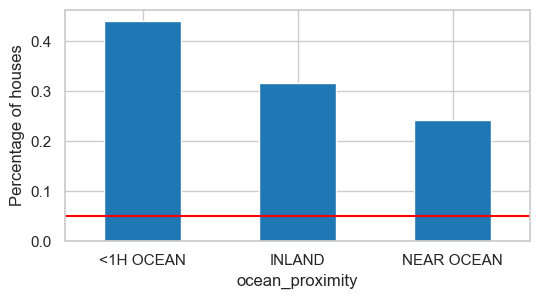

In [ ]:
temp_df = pd.Series(df['ocean_proximity'].value_counts() / len(df))

plt.figure(figsize=(6, 3))
fig = temp_df.sort_values(ascending=False).plot.bar(rot=0)
fig.set_xlabel('ocean_proximity')

fig.axhline(y=0.05, color='red')
fig.set_ylabel('Percentage of houses')
plt.show()

__Insight :__ 
* Setelah dilakukan handling rare label dapat dilihat bahwa Mayoritas perumahan berada dalam kategori '<1H OCEAN', 'INLAND', dan 'NEAR OCEAN' memiliki persentase lebih dari 5% atau diatas ambang batas.  

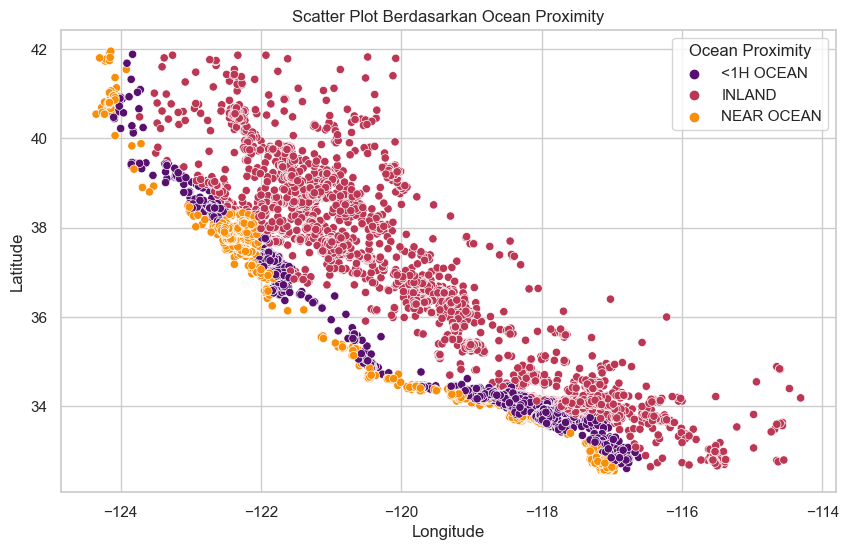

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming df_OceanProximity is a DataFrame containing the unique categories of 'ocean_proximity'
df['ocean_proximity'] = df['ocean_proximity'].astype('category')

plt.figure(figsize=(10, 6))  # Atur ukuran gambar
sns.scatterplot(data=df, x='longitude', y='latitude', hue='ocean_proximity',
                palette='inferno')

# Label sumbu dan judul
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Scatter Plot Berdasarkan Ocean Proximity')

# Tampilkan legend
plt.legend(title='Ocean Proximity')

plt.grid(True)  
plt.show() 


__Insight :__ 
* Dapat dilihat pola geografis dari distribusi rumah berdasarkan kategori 'ocean_proximity' wilayah di area 'INLAND' memiliki sebaran yang lebih luas, sementara 'NEAR OCEAN' dan '<1H OCEAN' cenderung lebih terkonsentrasi.

**Outlier,** pada dataset ini terdapat outliers yaitu pada kolom total_rooms, total_bedrooms, population, households, median_income, dan median_house_value (target). Sebelum memutuskan treatment yang sesuai dengan data, di antaranya adalah dengan mempertimbangkan sisi domain knowledge.

Deteksi dan kuantifikasi outlier:

<Axes: >

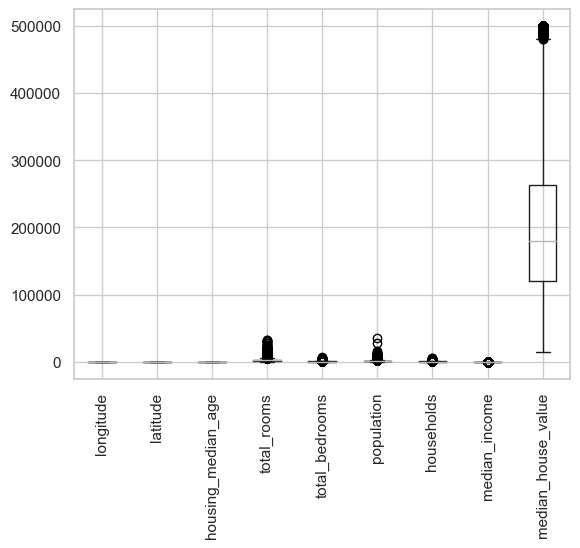

In [ ]:
df.boxplot(rot=90)

Dapat dilihat bahwa beberapa fitur memiliki sejumlah outliers yang signifikan dan data pada fitur-fitur tersebut memiliki variasi yang cukup besar di luar nilai-nilai kuartil. Pada kasus ini, tujuannya yaitu untuk membersihkan dataset dari outliers yang terdapat dalam beberapa fitur dengan menerapkan pendekatan gabungan antara metode IQR dan pengetahuan domain untuk mengatasi outliers.\
Dengan handling outliers akan menghasilkan sebuah dataset yang lebih bersih, di mana model yang akan dibangun hanya dapat memprediksi nilai-nilai rumah dalam rentang data yang telah dibersihkan. Nilai-nilai di luar rentang data ini akan dianggap sebagai nilai yang berpotensi menyebabkan bias dalam hasil prediksi model.

In [ ]:
# Mencari outliers
def find_outliers_IQR(df):
    q1=df.quantile(0.25)
    q3=df.quantile(0.75)
    IQR=q3-q1
    outliers = df[((df<(q1-1.5*IQR)) | (df>(q3+1.5*IQR)))]
    return outliers

In [ ]:
# Membuat fungsi untuk mengecek outliers
def find_anomalies(data):
    q1 = data.quantile(0.25)
    q3 = data.quantile(0.75)
    iqr = q3 - q1
    batas = iqr*1.5
    print(f'IQR: {iqr}')

    batas_bawah = q1 - batas
    batas_atas = q3 + batas
    print(f'Batas bawah: {batas_bawah}')
    print(f'Batas atas: {batas_atas}')        

**Total Rooms**

In [ ]:
# Outliers pada fitur total_rooms
find_anomalies(df['total_rooms'])

IQR: 1697.25
Batas bawah: -1094.875
Batas atas: 5694.125


In [ ]:
outliers = find_outliers_IQR(df['total_rooms'])
print('number of outliers: '+ str(len(outliers)))
print('max outlier value: '+ str(outliers.max()))
print('min outlier value: '+ str(outliers.min()))
outliers

number of outliers: 899
max outlier value: 32627
min outlier value: 5699


450       6202
2140     13802
2369      6257
2391      6102
4288      6403
         ...  
14116     8259
1746      6383
5242     13714
7594      5919
2867      8363
Name: total_rooms, Length: 899, dtype: int32

In [ ]:
n = len(data)
len(df[df.total_rooms >= 5694.125])
n_upper = len(np.where(df.total_rooms > 5694.125)[0])/n
n_lower = len(np.where(df.total_rooms < -1094.875)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 6.22%


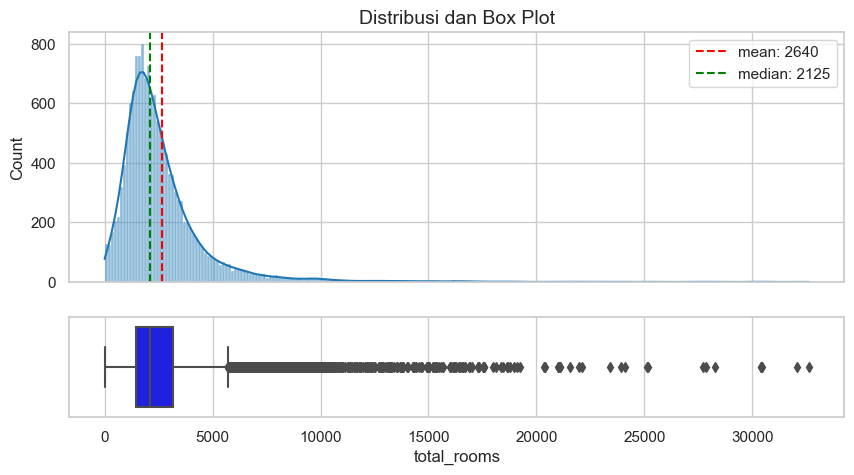

In [ ]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_rooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_rooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['total_rooms'].mean(), color='red', label=f"mean: {round(df['total_rooms'].mean())}", linestyle='--')
ax1.axvline(x=df['total_rooms'].median(), color='green', label=f"median: {round(df['total_rooms'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('total_rooms', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [ ]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.total_rooms)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


`HANDLING OUTLIER DI TOTAL ROOMS`

In [ ]:
# Identifikasi data-data yang merupakan outliers
outliers = df[df['total_rooms'] > 5694.125]
outliers

# Hapus outliers dari DataFrame
df = df[df['total_rooms'] <= 5694.125]

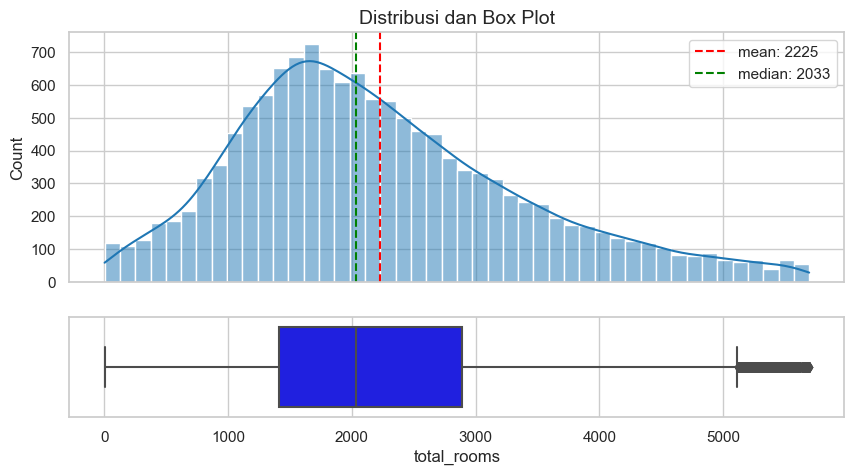

In [ ]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_rooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_rooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['total_rooms'].mean(), color='red', label=f"mean: {round(df['total_rooms'].mean())}", linestyle='--')
ax1.axvline(x=df['total_rooms'].median(), color='green', label=f"median: {round(df['total_rooms'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('total_rooms', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

**Total Bedrooms**

In [ ]:
# Outliers pada fitur total_rooms
find_anomalies(df['total_bedrooms'])

IQR: 309.0
Batas bawah: -176.5
Batas atas: 1059.5


In [ ]:
n = len(data)
len(df[df.total_bedrooms >= 1177.5])
n_upper = len(np.where(df.total_bedrooms > 1177.5)[0])/n
n_lower = len(np.where(df.total_bedrooms < -234.5)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 1.42%


In [ ]:
outliers = find_outliers_IQR(df['total_bedrooms'])
print('number of outliers: '+ str(len(outliers)))
print('max outlier value: '+ str(outliers.max()))
print('min outlier value: '+ str(outliers.min()))

number of outliers: 357
max outlier value: 2610
min outlier value: 1060


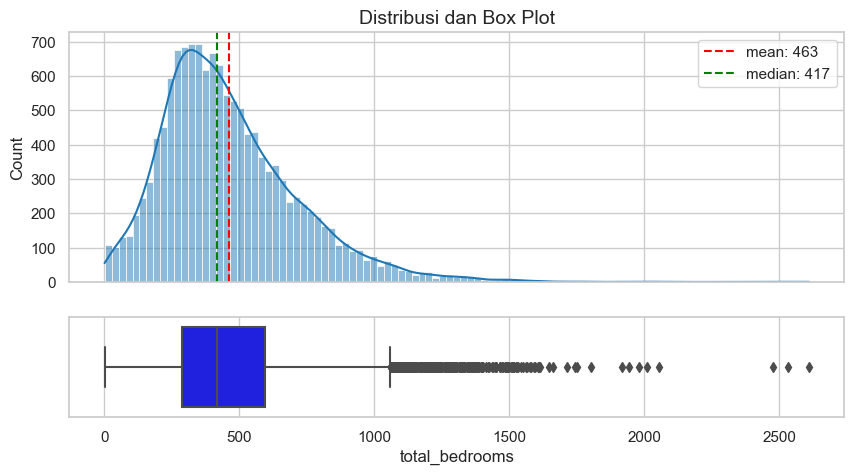

In [ ]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_bedrooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_bedrooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['total_bedrooms'].mean(), color='red', label=f"mean: {round(df['total_bedrooms'].mean())}", linestyle='--')
ax1.axvline(x=df['total_bedrooms'].median(), color='green', label=f"median: {round(df['total_bedrooms'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('total_bedrooms', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [ ]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.total_bedrooms)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


`HANDLING DISINI`

In [ ]:
# Identifikasi data-data yang merupakan outliers
outliers = df[df['total_bedrooms'] > 1175.625]
outliers

# Hapus outliers dari DataFrame
df = df[df['total_bedrooms'] <= 1175.625]

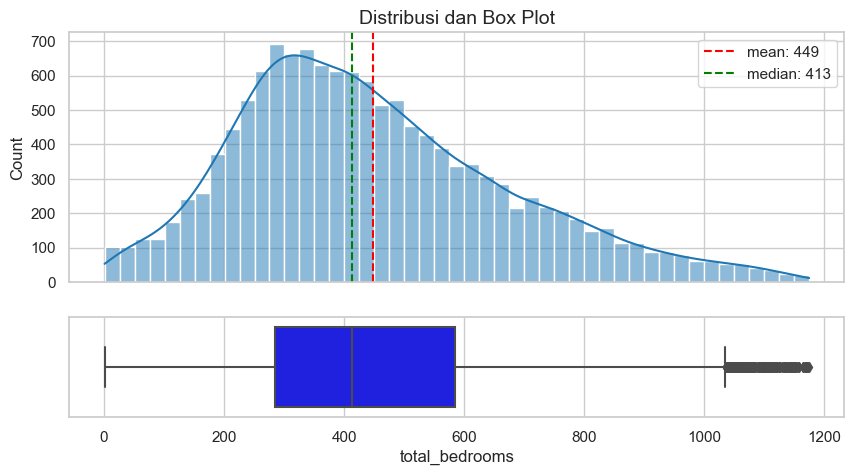

In [ ]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_bedrooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_bedrooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['total_bedrooms'].mean(), color='red', label=f"mean: {round(df['total_bedrooms'].mean())}", linestyle='--')
ax1.axvline(x=df['total_bedrooms'].median(), color='green', label=f"median: {round(df['total_bedrooms'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('total_bedrooms', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

Population

Tidak dilakukan handling outliers karena dalam kasus ini outliers memilki nilai-nilai yang wajar dan dapat memiliki interpretasi yang sah dalam konteks data tersebut.

Berdasarkan data:\
http://www.bayareacensus.ca.gov/counties/SanFranciscoCounty.htm

In [ ]:
# Outliers pada fitur total_rooms
find_anomalies(df['population'])

IQR: 803.0
Batas bawah: -443.5
Batas atas: 2768.5


In [ ]:
n = len(data)
len(df[df.population >= 2768.5])
n_upper = len(np.where(df.population > 2768.5)[0])/n
n_lower = len(np.where(df.population < -443.5)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 2.56%


In [ ]:
outliers = find_outliers_IQR(df['population'])
print('number of outliers: '+ str(len(outliers)))
print('max outlier value: '+ str(outliers.max()))
print('min outlier value: '+ str(outliers.min()))

number of outliers: 370
max outlier value: 8733
min outlier value: 2769


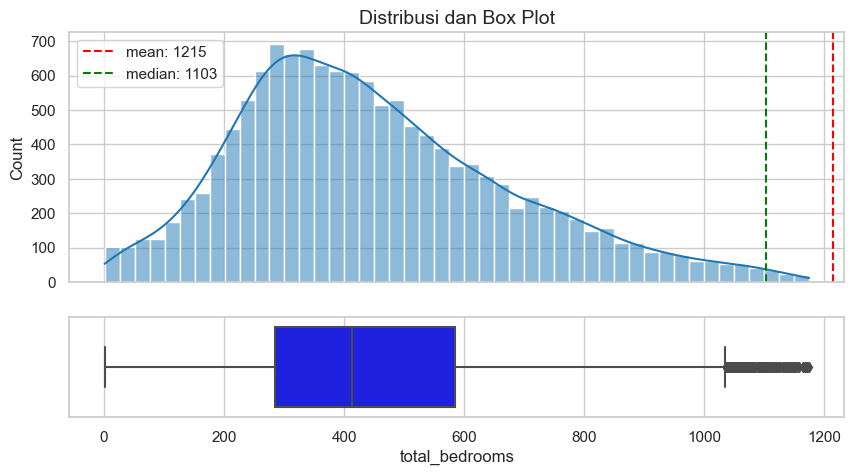

In [ ]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_bedrooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_bedrooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['population'].mean(), color='red', label=f"mean: {round(df['population'].mean())}", linestyle='--')
ax1.axvline(x=df['population'].median(), color='green', label=f"median: {round(df['population'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('population', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [ ]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.population)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


Households

Tidak dilakukan handling outliers karena dalam kasus ini outliers memilki nilai-nilai yang wajar dan dapat memiliki interpretasi yang sah dalam konteks data tersebut.

Berdasarkan data:\
http://www.bayareacensus.ca.gov/counties/SanFranciscoCounty.htm

In [ ]:
# Outliers pada fitur total_rooms
find_anomalies(df['households'])

IQR: 276.0
Batas bawah: -144.0
Batas atas: 960.0


In [ ]:
n = len(data)
len(df[df.households >= -208.5])
n_upper = len(np.where(df.households > 1091.5)[0])/n
n_lower = len(np.where(df.households < -208.5)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 0.07%


In [ ]:
outliers = find_outliers_IQR(df['households'])
print('number of outliers: '+ str(len(outliers)))
print('max outlier value: '+ str(outliers.max()))
print('min outlier value: '+ str(outliers.min()))

number of outliers: 208
max outlier value: 1537
min outlier value: 961


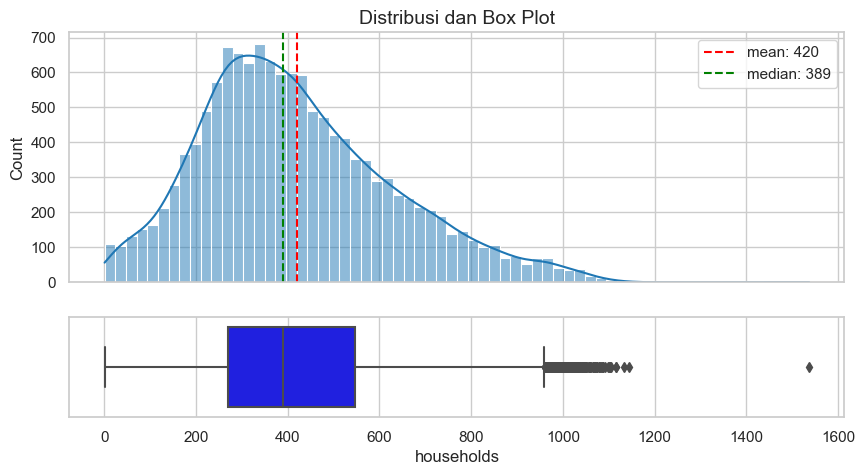

In [ ]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.households, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.households, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['households'].mean(), color='red', label=f"mean: {round(df['households'].mean())}", linestyle='--')
ax1.axvline(x=df['households'].median(), color='green', label=f"median: {round(df['households'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('households', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [ ]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.households)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

1.961817850054744e-44 Data tidak terdistribusi normal.


Median Income

Alasan:\
Median_income di handling karena menurut data pemerintah US diketahu bahwa median indome pada negara bagian California pada tahun 1990 yaitu sebesar 59,790. 
Sedangkan pada dataset ini diketahui max value pada median income sebesar 15.0001 (belum diukur dalam puluhan ribu Dolar AS) dan value tersebut tergolong diatas median income california.
https://nces.ed.gov/programs/digest/d10/tables/dt10_025.asp

In [ ]:
# Outliers pada fitur total_rooms
find_anomalies(df['median_income'])

IQR: 2.144049999999999
Batas bawah: -0.6731749999999983
Batas atas: 7.903024999999998


In [ ]:
n = len(data)
len(df[df.median_income >= -208.5])
n_upper = len(np.where(df.median_income > 7.983412500000001)[0])/n
n_lower = len(np.where(df.median_income < -0.6760875000000004)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 2.92%


In [ ]:
outliers = find_outliers_IQR(df['median_income'])
print('number of outliers: '+ str(len(outliers)))
print('max outlier value: '+ str(outliers.max()))
print('min outlier value: '+ str(outliers.min()))

number of outliers: 440
max outlier value: 15.0001
min outlier value: 7.9059


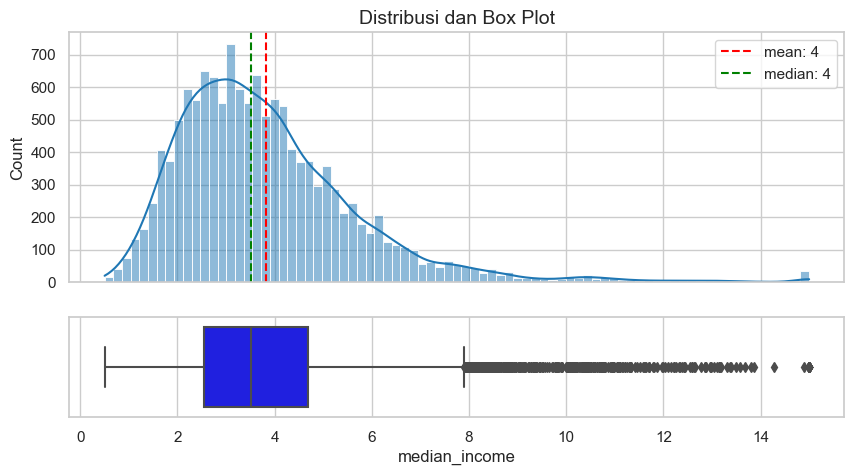

In [ ]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.median_income, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.median_income, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['median_income'].mean(), color='red', label=f"mean: {round(df['median_income'].mean())}", linestyle='--')
ax1.axvline(x=df['median_income'].median(), color='green', label=f"median: {round(df['median_income'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('median_income', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [ ]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.median_income)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


`HANDLING DISINI`

In [ ]:
# Melakukan filtering pada data
df = df[(df['median_income'] <= 7.903024999999998)]

Median House Value

In [ ]:
# Outliers pada fitur total_rooms
find_anomalies(df['median_house_value'])

IQR: 134400.0
Batas bawah: -86500.0
Batas atas: 451100.0


In [ ]:
n = len(data)
len(df[df.median_house_value >= 476300.0])
n_upper = len(np.where(df.median_income > 476300.0)[0])/n
n_lower = len(np.where(df.median_income < -98100.0)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 0.0%


In [ ]:
# Melakukan filtering pada data
df = df[(df['median_house_value'] <= 452500.0)]

#### **Feature Engineering**

Encoding:\
Agar dapat menggunakan semua fitur yang dipilih, maka fitur kategorikal harus diubah menjadi fitur numerikal. Fitur ocean_proximity tidak memiliki tingkatan yang jelas, oleh karena itu menggunakan OneHotEncoder. Saya akan menggunakan column transformer untuk mengubah tipe datanya, yang nanti akan diaplikasikan pada pipeline model.

In [ ]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder

# Menentukan kolom transformer
transformer = ColumnTransformer([
    ('One Hot', OneHotEncoder(drop='first'), ['ocean_proximity']),
], remainder='passthrough')

transformer

ColumnTransformer(remainder='passthrough',
                  transformers=[('One Hot', OneHotEncoder(drop='first'),
                                 ['ocean_proximity'])])

Feature Creation:

Alasan:
Ketika mengevaluasi harga sebuah properti, informasi mengenai jumlah kamar secara keseluruhan di suatu area mungkin tidak memberikan wawasan yang substansial. Lebih relevan untuk mempertimbangkan jumlah kamar per household, mengingat bahwa jumlah kamar dalam sebuah rumah dapat memiliki dampak terhadap penilaian harga. Selain itu, penting untuk mempertimbangkan hubungan antara jumlah kamar tidur dalam sebuah rumah dengan jumlah total kamar yang ada. Tambahan informasi yang bermanfaat adalah karakteristik jumlah anggota keluarga dalam setiap rumah tangga, karena hal ini berkaitan dengan ukuran properti yang pada akhirnya mempengaruhi harga properti tersebut.

Avg total rooms : berisikan informasi terkait rata rata total ruangan di dalam satu rumah 

In [ ]:
df['avg_rooms_per_house'] = round(df['total_rooms'] / df['households'])

Avg bedrooms per house : Informasi terkait rata rata kamar tidur di dalam satu rumah

In [ ]:
df['avg_bedrooms_per_house'] = round(df['total_bedrooms'] / df['households'])

Avg person per house : Informasi terkait rata rata jumlah orang yang dapat tinggal di dalam satu rumah

In [ ]:
df['avg_persons_per_house'] = round(df['population'] / df['households'])

Distance antar city: Informasi terkait seberapa jauh rumah terhadap pusat kota atau kota kota besar yang berada di California.

Alasan:
* General:\
Penambahan kolom "Distance antar city" memiliki tujuan untuk memberikan informasi mengenai seberapa jauh suatu rumah terletak dari pusat kota atau kota-kota besar yang menjadi pusat aktivitas dan bisnis di wilayah California. Jarak rumah dari pusat kota dapat menjadi faktor penting dalam menilai nilai properti, karena lokasi yang lebih dekat dengan pusat aktivitas umumnya memiliki potensi nilai properti yang lebih tinggi.

* Spesifik (per city):
    - San Francisco : memiliki peran signifikan dalam bidang keuangan, teknologi, budaya, dan pariwisata di California.
    - San Jose, sebagai kota terbesar ketiga di California, adalah pusat utama wilayah Silicon Valley yang mengemuka dalam inovasi teknologi dan industri teknologi informasi global.
    - San Diego, yang terkenal karena industri militer, pariwisata, dan pelabuhan laut, juga bukan ibu kota California.
    - Sacramento, dengan lokasinya yang sentral, berfungsi sebagai pusat pemerintahan California.
    - Los Angeles, sebagai kota terpadat di California dan kedua terpadat di AS, memiliki peran vital dalam komersial, keuangan, budaya, dan hiburan di negara bagian dan seluruh negara.

In [ ]:
def haversine(lat1, lon1, lat2, lon2):
    # Mengubah derajat menjadi radian
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
    
    # Rumus haversine
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a)) 
    r = 6371 # Radius bumi dalam kilometer
    return c * r

# Koordinat Los Angeles dan San Francisco
lat_LA, lon_LA = 34.05, -118.25
lat_SF, lon_SF = 37.77, -122.42
lat_Sac, lon_Sac = 38.58, -121.49
lat_SJ, lon_SJ = 37.34, -121.89
lat_SD, lon_SD = 32.72, -117.16

# Menghitung jarak ke Los Angeles dan San Francisco
df['distance_to_LA'] = df.apply(lambda row: haversine(row['latitude'], row['longitude'], lat_LA, lon_LA), axis=1)
df['distance_to_SF'] = df.apply(lambda row: haversine(row['latitude'], row['longitude'], lat_SF, lon_SF), axis=1)
df['distance_to_Sac'] = df.apply(lambda row: haversine(row['latitude'], row['longitude'], lat_Sac, lon_Sac), axis=1)
df['distance_to_SJ'] = df.apply(lambda row: haversine(row['latitude'], row['longitude'], lat_SJ, lon_SJ), axis=1)
df['distance_to_SD'] = df.apply(lambda row: haversine(row['latitude'], row['longitude'], lat_SD, lon_SD), axis=1)


Feature Selection:

In [ ]:
selected_columns1 = ['median_house_value',  'distance_to_LA', 'distance_to_SF','distance_to_Sac', 'distance_to_SJ', 'distance_to_SD']
correlation_matrix1 = df[selected_columns1].corr()
correlation_matrix1


,median_house_value,distance_to_LA,distance_to_SF,distance_to_Sac,distance_to_SJ,distance_to_SD
median_house_value,1.000000,-0.140475,-0.030635,0.064598,-0.042765,-0.104100
distance_to_LA,-0.140475,1.000000,-0.835786,-0.869568,-0.777003,0.951266
distance_to_SF,-0.030635,-0.835786,1.000000,0.978245,0.989592,-0.918218
distance_to_Sac,0.064598,-0.869568,0.978245,1.000000,0.961289,-0.947666
distance_to_SJ,-0.042765,-0.777003,0.989592,0.961289,1.000000,-0.874183
distance_to_SD,-0.104100,0.951266,-0.918218,-0.947666,-0.874183,1.000000


fitur yang sekitarnya memilki pengaruh terhadap target:
- housing median age
- avg rooms per house
- avg bedrooms per house 
- avg_persons_per_house
- population
- households (penting karena untuk tau kelangkaan rumah diwilayah tersebut, karena jika population tinggi tetapi jumlah rumah sedikit maka dapat dikatakan bahwa harga rumah cenderung lebih tinggi karena permintaan tinggi dan pasokan terbatas.)
- ocean_proximity
- distance_to_LA	
- distance_to_SF	
- distance_to_Sac	
- distance_to_SJ	
- distance_to_SD


Target:
- median_house_value

**Clean Dataset**

In [ ]:
df_model = df[['longitude', 'latitude', 'housing_median_age', 'avg_rooms_per_house', 'avg_bedrooms_per_house','avg_persons_per_house','population', 'households', 'median_income',
       'ocean_proximity','distance_to_LA', 'distance_to_SF','distance_to_Sac', 'distance_to_SJ', 'distance_to_SD', 'median_house_value']]

In [ ]:
df_model

,longitude,latitude,housing_median_age,avg_rooms_per_house,avg_bedrooms_per_house,avg_persons_per_house,population,households,median_income,ocean_proximity,distance_to_LA,distance_to_SF,distance_to_Sac,distance_to_SJ,distance_to_SD,median_house_value
0,-119.79,36.73,52,3.0,1.0,5.0,193,40,1.9750,INLAND,329.065723,259.912510,254.377641,198.354556,506.488043,47500.0
4,-119.81,36.73,50,5.0,1.0,4.0,606,167,2.2206,INLAND,329.838549,258.328567,253.346102,196.687370,507.357029,59200.0
25,-120.38,36.76,12,4.0,1.0,4.0,1043,243,1.4038,INLAND,357.844957,212.601407,224.717533,148.715185,536.915541,54300.0
32,-119.83,36.80,24,5.0,1.0,2.0,1586,739,3.8571,INLAND,337.624967,253.241125,245.978009,192.373712,515.022512,90100.0
58,-119.81,36.71,25,6.0,1.0,4.0,789,183,1.5625,INLAND,327.838461,259.358748,255.166474,197.487914,505.418290,52800.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5365,-120.24,39.67,40,6.0,1.0,3.0,305,110,2.3625,INLAND,649.458010,283.536597,162.220617,296.192528,820.588494,62500.0
9082,-120.48,39.66,32,12.0,2.0,2.0,304,131,1.8839,INLAND,654.531321,269.237485,148.366872,285.655342,827.035100,71000.0
9199,-120.23,39.56,14,6.0,1.0,3.0,734,287,2.4600,INLAND,637.488715,275.244923,153.966143,286.050392,808.845455,93000.0
13753,-120.92,39.56,48,9.0,2.0,2.0,358,145,1.8750,INLAND,657.091505,237.850492,119.565420,260.899981,831.930192,66600.0


**Data Splitting**

Bagi dataset menjadi train dan test dengan komposisi 70:30

In [ ]:
from sklearn.model_selection import train_test_split

X = df_model.drop(columns='median_house_value')
y = df_model['median_house_value']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)
X_train.shape, X_test.shape

((8703, 15), (3730, 15))

In [ ]:
df_model

,longitude,latitude,housing_median_age,avg_rooms_per_house,avg_bedrooms_per_house,avg_persons_per_house,population,households,median_income,ocean_proximity,distance_to_LA,distance_to_SF,distance_to_Sac,distance_to_SJ,distance_to_SD,median_house_value
0,-119.79,36.73,52,3.0,1.0,5.0,193,40,1.9750,INLAND,329.065723,259.912510,254.377641,198.354556,506.488043,47500.0
4,-119.81,36.73,50,5.0,1.0,4.0,606,167,2.2206,INLAND,329.838549,258.328567,253.346102,196.687370,507.357029,59200.0
25,-120.38,36.76,12,4.0,1.0,4.0,1043,243,1.4038,INLAND,357.844957,212.601407,224.717533,148.715185,536.915541,54300.0
32,-119.83,36.80,24,5.0,1.0,2.0,1586,739,3.8571,INLAND,337.624967,253.241125,245.978009,192.373712,515.022512,90100.0
58,-119.81,36.71,25,6.0,1.0,4.0,789,183,1.5625,INLAND,327.838461,259.358748,255.166474,197.487914,505.418290,52800.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5365,-120.24,39.67,40,6.0,1.0,3.0,305,110,2.3625,INLAND,649.458010,283.536597,162.220617,296.192528,820.588494,62500.0
9082,-120.48,39.66,32,12.0,2.0,2.0,304,131,1.8839,INLAND,654.531321,269.237485,148.366872,285.655342,827.035100,71000.0
9199,-120.23,39.56,14,6.0,1.0,3.0,734,287,2.4600,INLAND,637.488715,275.244923,153.966143,286.050392,808.845455,93000.0
13753,-120.92,39.56,48,9.0,2.0,2.0,358,145,1.8750,INLAND,657.091505,237.850492,119.565420,260.899981,831.930192,66600.0


### `Modeling`

**Model Experiment**

Bandingkan model regresi untuk mendapatkan benchmark model:

In [ ]:
# Define algoritma yang digunakan
lr = LinearRegression()
knn = KNeighborsRegressor()
dt = DecisionTreeRegressor(random_state=1)
rf = RandomForestRegressor(random_state=1)
xgb = XGBRegressor(random_state=1)

# Pemodelan dilakukan dalam skala logaritmik, namun kemudian di-inverse kembali untuk interpretasi
log_lr = TransformedTargetRegressor(lr, func=np.log, inverse_func=np.exp)
log_knn = TransformedTargetRegressor(knn, func=np.log, inverse_func=np.exp)
log_dt = TransformedTargetRegressor(dt, func=np.log, inverse_func=np.exp)
log_rf = TransformedTargetRegressor(rf, func=np.log, inverse_func=np.exp)
log_xgb = TransformedTargetRegressor(xgb, func=np.log, inverse_func=np.exp)

# Scaling data
scaler = StandardScaler()

# Kandidat algoritma
models = [log_lr, log_knn, log_dt, log_rf, log_xgb]

score_rmse = []
nilai_mean_rmse = []
nilai_std_rmse = []

score_mae = []
nilai_mean_mae = []
nilai_std_mae = []

score_mape = []
nilai_mean_mape = []
nilai_std_mape = []

# Mencari algoritma terbaik berdasarkan tiap metrics
for i in models:
    
    crossval = KFold(n_splits=5, shuffle=True, random_state=1)

    estimator = Pipeline([
        ('preprocessing', transformer),
        ('scaler', scaler),
        ('model', i)
    ])

    # RMSE
    model_cv_rmse = cross_val_score(
        estimator, 
        X_train, 
        y_train, 
        cv=crossval, 
        scoring='neg_root_mean_squared_error', 
        error_score='raise'
        )

    print(model_cv_rmse, i)

    score_rmse.append(model_cv_rmse)
    nilai_mean_rmse.append(model_cv_rmse.mean())
    nilai_std_rmse.append(model_cv_rmse.std())

    # MAE
    model_cv_mae = cross_val_score(
        estimator, 
        X_train, 
        y_train, 
        cv=crossval, 
        scoring='neg_mean_absolute_error', 
        error_score='raise'
        )

    print(model_cv_mae, i)

    score_mae.append(model_cv_mae)
    nilai_mean_mae.append(model_cv_mae.mean())
    nilai_std_mae.append(model_cv_mae.std())

    # MAPE
    model_cv_mape = cross_val_score(
        estimator, 
        X_train, 
        y_train, 
        cv=crossval, 
        scoring='neg_mean_absolute_percentage_error', 
        error_score='raise'
        )

    print(model_cv_mape, i)

    score_mape.append(model_cv_mape)
    nilai_mean_mape.append(model_cv_mape.mean())
    nilai_std_mape.append(model_cv_mape.std())

[-55744.00218548 -54756.28911245 -56466.57346982 -59458.09784193
 -57779.86240544] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression())
[-39860.90451089 -39768.51779605 -40464.24612471 -41674.07296537
 -41166.45704941] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression())
[-0.23489727 -0.24077281 -0.23952302 -0.24250498 -0.23668056] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression())
[-50315.37900752 -51732.03848107 -52446.1319276  -54328.15093496
 -54632.34440812] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=KNeighborsRegressor())


[-35555.68855294 -35719.4573314  -36614.67784978 -37124.16736555
 -37267.00082267] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=KNeighborsRegressor())
[-0.20142973 -0.20701161 -0.21158277 -0.21100825 -0.20849542] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=KNeighborsRegressor())
[-59879.05774623 -57392.48440292 -59437.65208287 -61022.71852051
 -62311.42410433] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=DecisionTreeRegressor(random_state=1))
[-40601.20620333 -38372.54451465 -39492.59103963 -40539.94367816
 -41076.95574713] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=DecisionTreeRegressor(random_state=1))
[-0.23582022 -0.23517685 -0.23010119 -0.24410117 -0.23820202] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_

In [ ]:
# Evaluasi hasil dari 5 kandidat algoritma yang digunakan
pd.DataFrame({
    'Model': ['Linear Regression', 'KNN Regressor', 'DecisionTree Regressor', 'RandomForest Regressor', 'XGBoost Regressor'],
    'Mean_RMSE': nilai_mean_rmse,
    'Std_RMSE': nilai_std_rmse,
    'Mean_MAE': nilai_mean_mae,
    'Std_MAE': nilai_std_mae,
    'Mean_MAPE': nilai_mean_mape,
    'Std_MAPE': nilai_std_mape
})

,Model,Mean_RMSE,Std_RMSE,Mean_MAE,Std_MAE,Mean_MAPE,Std_MAPE
0,Linear Regression,-56840.965003,1638.309045,-40586.839689,738.876751,-0.238876,0.002751
1,KNN Regressor,-52690.808952,1616.924474,-36456.198384,704.613970,-0.207906,0.003640
2,DecisionTree Regressor,-60008.667371,1644.278489,-40016.648237,971.340429,-0.236680,0.004553
3,RandomForest Regressor,-44220.681688,1371.518728,-29030.526097,630.624667,-0.166812,0.004300
4,XGBoost Regressor,-42493.821568,1184.037283,-28109.798804,553.840576,-0.162737,0.001372


Tabel diatas merupakan hasil evaluasi kinerja berbagai model regresi berdasarkan beberapa metrik, seperti Root Mean Squared Error (RMSE), Mean Absolute Error (MAE), dan Mean Absolute Percentage Error (MAPE). Setiap metrik dihitung dalam bentuk nilai rata-rata (Mean) dan standar deviasi (Std) dari pengujian yang dilakukan.

__Insight:__
* Dari metrik evaluasi yang digunakan (Mean RMSE, Mean MAE, Mean MAPE), terlihat bahwa model XGBoost Regressor cenderung memiliki kinerja yang lebih baik dalam memprediksi nilai target dibandingkan dengan model lainnya. Ini ditunjukkan oleh Mean RMSE dan Mean MAE yang lebih rendah untuk XGBoost Regressor.

* Dilihat dari Standar Deviasi (Std_RMSE dan Std_MAE), XGBoost Regressor juga menunjukkan stabilitas dalam kinerjanya, dengan nilai yang lebih rendah. Hal ini mengindikasikan bahwa model ini cenderung memberikan hasil yang konsisten di berbagai skenario.

* DecisionTree Regressor tampak memiliki perbedaan kinerja antara data latih dan data uji yang lebih signifikan, ditunjukkan oleh selisih Mean RMSE dan Mean MAE yang tinggi. Ini bisa mengindikasikan adanya overfitting, di mana model DecisionTree mencoba terlalu keras untuk "menghafal" data latih dan karenanya tidak umum.

* Random Forest dan XGBoost Regressor cenderung memiliki selisih antara Mean RMSE/Mean MAE dari data latih dan uji yang lebih rendah. Ini menunjukkan bahwa kedua model ini mampu lebih baik dalam menggeneralisasikan pola dari data latih ke data yang tidak dilihat sebelumnya.

**Predict to Test Set with the Benchmark Model**

Prediksi pada test set dengan menggunakan model XGBoost dan Random Forest

In [ ]:
# Benchmark 2 model terbaik
models = {
    'XGB': XGBRegressor(random_state=1),
    'RandomForest': RandomForestRegressor(random_state=1)
}

score_rmse = []
score_mae = []
score_mape = []

# Prediksi pada test set
for i in models:

    model = Pipeline([
        ('preprocessing', transformer),
        ('scaler', scaler),
        ('model', models[i])
        ])

    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    score_rmse.append(np.sqrt(mean_squared_error(y_test, y_pred)))
    score_mae.append(mean_absolute_error(y_test, y_pred))
    score_mape.append(mean_absolute_percentage_error(y_test, y_pred))

score_before_tuning = pd.DataFrame({'RMSE': score_rmse, 'MAE': score_mae, 'MAPE': score_mape}, index=models.keys())
score_before_tuning

,RMSE,MAE,MAPE
XGB,40769.698688,27302.280021,0.169440
RandomForest,42325.598205,28450.001869,0.175366


__Insight:__

Dalam melakukan Comparing Metrics atau membandingkan tiga metrik evaluasi, yaitu Root Mean Squared Error (RMSE), Mean Absolute Error (MAE), dan Mean Absolute Percentage Error (MAPE), untuk kedua model (XGBoost dan RandomForest) didapatkan bahwa:

* Model Comparison - RMSE: Model XGBoost memiliki nilai RMSE sebesar 41075.334 yang lebih rendah daripada nilai RMSE model RandomForest yaitu 42219.150. Secara umum, nilai RMSE yang lebih rendah menunjukkan bahwa model XGBoost memiliki tingkat kesalahan prediksi yang lebih rendah dalam hal perbedaan absolut antara prediksi dan nilai sebenarnya.

* Model Comparison - MAE: Model XGBoost juga memiliki nilai MAE yang lebih rendah yaitu 27868.860 jika dibandingkan dengan nilai MAE model RandomForest yaitu 28590.637. Nilai MAE yang lebih rendah menunjukkan bahwa model XGBoost memiliki tingkat kesalahan prediksi yang lebih rendah dalam skala absolut.

* Model Comparison - MAPE: Model XGBoost memiliki MAPE sebesar 0.173, sedangkan model RandomForest memiliki MAPE sebesar 0.176. MAPE yang lebih rendah menunjukkan bahwa model XGBoost memiliki kesalahan prediksi relatif yang lebih rendah dalam bentuk persentase.

* Model Performance: Berdasarkan nilai-nilai metrik, model XGBoost memberikan kinerja yang sedikit lebih baik daripada model RandomForest dalam hal keseluruhan prediksi.

**Hyperparameter Tuning**

Melakukan penyetelan hyperparameter pada model XGBoost dengan tujuan meningkatkan performa secara signifikan, dikarekan XGBoost memiliki performa model yang lebih baik dibandingkan dengan model RandomForest. 

XGBoost (Extreme Gradient Boosting) adalah sebuah metode machine learning yang termasuk dalam kelompok algoritma ensemble, khususnya algoritma boosting. XGBoost bertujuan untuk meningkatkan kinerja model prediksi dengan menggabungkan banyak model lemah (weak learners) menjadi model yang lebih kuat. Algoritma ini menggabungkan prinsip-prinsip dari gradient boosting dengan peningkatan efisiensi dan performa menggunakan teknik seperti regularisasi dan optimalisasi berbasis histogram. XGBoost sering digunakan dalam kasus regresi dan klasifikasi, serta memiliki kemampuan untuk menangani data yang besar dengan cepat dan efisien.

In [ ]:
# Kedalaman pohon
max_depth = list(np.arange(1, 11))

# Learning rate
learning_rate = list(np.arange(1, 100)/100)

# Jumlah pohon
n_estimators = list(np.arange(100, 201))

# Jumlah baris tiap pohon (% dari total baris train set)
subsample = list(np.arange(2, 10)/10)

# Gamma (min_impurity_decrease)
gamma = list(np.arange(1, 11)) # Semakin besar nilainya, semakin konservatif/simpel modelnya

# Jumlah feature yang digunakan untuk tiap pohon (% dari total kolom train set)
colsample_bytree = list(np.arange(1, 10)/10)

# Alpha (regularization)
reg_alpha = list(np.logspace(-3, 1, 10)) # Semakin besar nilainya, semakin konservatif/simpel modelnya


# Hyperparam space XGboost
hyperparam_space_xgb = {
    'model__max_depth': max_depth, 
    'model__learning_rate': learning_rate,
    'model__n_estimators': n_estimators,
    'model__subsample': subsample,
    'model__gamma': gamma,
    'model__colsample_bytree': colsample_bytree,
    'model__reg_alpha': reg_alpha
}

In [ ]:
# Benchmark model dengan hyperparameter tuning
xgb = XGBRegressor(random_state=1, verbosity=0)

# Membuat algorithm chains
estimator_xgb = Pipeline([
        ('preprocessing', transformer),
        ('scaler', scaler),
        ('model', xgb)
        ])

crossval = KFold(n_splits=5, shuffle=True, random_state=1)

# Hyperparameter tuning
random_xgb = RandomizedSearchCV(
    estimator_xgb, 
    param_distributions = hyperparam_space_xgb,
    n_iter = 50,
    cv = crossval, 
    scoring = ['neg_root_mean_squared_error', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error'], 
    n_jobs = -1,
    refit = 'neg_root_mean_squared_error', # Hanya bisa memilih salah stau metric untuk optimisasi
    random_state = 1  
)

In [ ]:
# Fitting data training untuk mencari parameter terbaik
random_xgb.fit(X_train, y_train)

RandomizedSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
                   estimator=Pipeline(steps=[('preprocessing',
                                              ColumnTransformer(remainder='passthrough',
                                                                transformers=[('One '
                                                                               'Hot',
                                                                               OneHotEncoder(drop='first'),
                                                                               ['ocean_proximity'])])),
                                             ('scaler', StandardScaler()),
                                             ('model',
                                              XGBRegressor(base_score=None,
                                                           booster=None,
                                                           callbacks=None,
                                                           colsample_bylevel=None,
                                                           co...
                                                             0.007742636826811269,
                                                             0.021544346900318832,
                                                             0.05994842503189409,
                                                             0.1668100537200059,
                                                             0.46415888336127775,
                                                             1.2915496650148828,
                                                             3.593813663804626,
                                                             10.0],
                                        'model__subsample': [0.2, 0.3, 0.4, 0.5,
                                                             0.6, 0.7, 0.8,
                                                             0.9]},
                   random_state=1, refit='neg_root_mean_squared_error',
                   scoring=['neg_root_mean_squared_error',
                            'neg_mean_absolute_error',
                            'neg_mean_absolute_percentage_error'])

In [ ]:
# Melihat hasil tuning dalam bentuk dataframe. Diurutkan berdasarkan RMSE, MAE & MAPE
pd.DataFrame(random_xgb.cv_results_).sort_values(by=['rank_test_neg_root_mean_squared_error', 'rank_test_neg_mean_absolute_error', 'rank_test_neg_mean_absolute_percentage_error']).head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_model__subsample,param_model__reg_alpha,param_model__n_estimators,param_model__max_depth,param_model__learning_rate,param_model__gamma,param_model__colsample_bytree,params,split0_test_neg_root_mean_squared_error,split1_test_neg_root_mean_squared_error,split2_test_neg_root_mean_squared_error,split3_test_neg_root_mean_squared_error,split4_test_neg_root_mean_squared_error,mean_test_neg_root_mean_squared_error,std_test_neg_root_mean_squared_error,rank_test_neg_root_mean_squared_error,split0_test_neg_mean_absolute_error,split1_test_neg_mean_absolute_error,split2_test_neg_mean_absolute_error,split3_test_neg_mean_absolute_error,split4_test_neg_mean_absolute_error,mean_test_neg_mean_absolute_error,std_test_neg_mean_absolute_error,rank_test_neg_mean_absolute_error,split0_test_neg_mean_absolute_percentage_error,split1_test_neg_mean_absolute_percentage_error,split2_test_neg_mean_absolute_percentage_error,split3_test_neg_mean_absolute_percentage_error,split4_test_neg_mean_absolute_percentage_error,mean_test_neg_mean_absolute_percentage_error,std_test_neg_mean_absolute_percentage_error,rank_test_neg_mean_absolute_percentage_error
3,4.187076,0.559618,0.064291,0.015291,0.5,0.021544,166,8,0.1,9,0.3,"{'model__subsample': 0.5, 'model__reg_alpha': ...",-38813.897440,-39563.147460,-41088.816843,-41836.737300,-42131.190487,-40686.757906,1291.556908,1,-26228.094650,-26563.428386,-27482.006969,-28492.258203,-28225.708506,-27398.299343,889.353407,1,-0.158852,-0.166120,-0.172201,-0.174258,-0.169793,-0.168245,0.005421,2
7,7.446831,0.301682,0.040241,0.004118,0.9,0.059948,119,8,0.05,5,0.8,"{'model__subsample': 0.9, 'model__reg_alpha': ...",-38650.216186,-40762.892792,-41135.607008,-41437.290256,-42980.147026,-40993.230654,1393.418024,2,-26543.831677,-27418.008201,-27512.441684,-28065.956834,-28282.148781,-27564.477435,605.377976,2,-0.159481,-0.170392,-0.168265,-0.168017,-0.165645,-0.166360,0.003754,1
23,2.232655,0.094527,0.034802,0.012271,0.9,3.593814,153,4,0.33,9,0.3,"{'model__subsample': 0.9, 'model__reg_alpha': ...",-40901.228557,-41235.033349,-41932.646639,-42022.555670,-43501.624449,-41918.617733,896.580004,3,-28757.891655,-28559.763525,-28871.698211,-29068.923032,-29754.088263,-29002.472937,410.427794,4,-0.173337,-0.180430,-0.178121,-0.174829,-0.181387,-0.177621,0.003114,5
13,4.329488,0.150325,0.090059,0.040862,0.6,0.059948,171,9,0.18,4,0.2,"{'model__subsample': 0.6, 'model__reg_alpha': ...",-38932.809808,-41127.616624,-42455.543585,-42628.630544,-44478.276197,-41924.575351,1837.651396,4,-26904.300319,-28286.515709,-28482.845236,-29894.635536,-30224.618173,-28758.582995,1198.091615,3,-0.164128,-0.177808,-0.178440,-0.182162,-0.181637,-0.176835,0.006579,3
22,2.592332,0.331683,0.031201,0.009517,0.7,0.002783,155,4,0.25,8,0.3,"{'model__subsample': 0.7, 'model__reg_alpha': ...",-40917.155605,-41889.820593,-42610.285944,-42914.036934,-43334.209652,-42333.101746,850.639226,5,-28491.907620,-29169.938317,-29204.399650,-29584.926997,-29385.046114,-29167.243740,368.609244,7,-0.171219,-0.185999,-0.181529,-0.180495,-0.179611,-0.179770,0.004808,7


In [ ]:
# Cek skor dan params terbaik
print('XGBoost')
print('Best_score:', random_xgb.best_score_)
print('Best_params:', random_xgb.best_params_)

XGBoost
Best_score: -40686.75790599807
Best_params: {'model__subsample': 0.5, 'model__reg_alpha': 0.021544346900318832, 'model__n_estimators': 166, 'model__max_depth': 8, 'model__learning_rate': 0.1, 'model__gamma': 9, 'model__colsample_bytree': 0.3}


**Predict to Test Set with the Tuned Model**

Melakukan prediksi pada test set dengan menggunakan model XGBoost dan hyperparameter terpilih.

In [ ]:
# Model XGBoost
model = {'XGB': XGBRegressor(random_state=1)}

# Define model terhadap estimator terbaik
xgb_tuning = random_xgb.best_estimator_

# Fitting model
xgb_tuning.fit(X_train, y_train)

# Predict test set
y_pred_xgb_tuning = xgb_tuning.predict(X_test)

# Simpan nilai metrics RMSE, MAE & MAPE setelah tuning
rmse_xgb_tuning = np.sqrt(mean_squared_error(y_test, y_pred_xgb_tuning))
mae_xgb_tuning = mean_absolute_error(y_test, y_pred_xgb_tuning)
mape_xgb_tuning = mean_absolute_percentage_error(y_test, y_pred_xgb_tuning)

score_after_tuning = pd.DataFrame({'RMSE': rmse_xgb_tuning, 'MAE': mae_xgb_tuning, 'MAPE': mape_xgb_tuning}, index=model.keys())
score_after_tuning

,RMSE,MAE,MAPE
XGB,39665.642634,26886.590311,0.168381


**Performance Comparison**

Perbandingan performa model XGBoost sebelum dan sesudah dilakukan hyperparameter tuning.

In [ ]:
# Sebelum hyperparameter tuning
pd.DataFrame(score_before_tuning.loc['XGB']).T

,RMSE,MAE,MAPE
XGB,40769.698688,27302.280021,0.16944


In [ ]:
# Setelah hyperparameter tuning
score_after_tuning

,RMSE,MAE,MAPE
XGB,39665.642634,26886.590311,0.168381


__Insight:__

Setelah melakukan hyperparameter tuning pada model XGBoost, terdapat peningkatan kinerja secara signifikan. Sebelum tuning, model XGBoost memiliki RMSE sebesar 40769.698688, MAE sebesar 27302.280021, dan MAPE sebesar 0.16944. Namun, setelah melakukan tuning, nilai RMSE berhasil berkurang menjadi 39665.642634, MAE menurun menjadi 26886.590311, dan MAPE mengalami penurunan menjadi 0.168381. Hal ini menunjukkan bahwa penyetelan hiperparameter telah berhasil meningkatkan kemampuan prediksi model XGBoost, dengan kesalahan prediksi yang lebih rendah dan tingkat akurasi yang lebih baik.

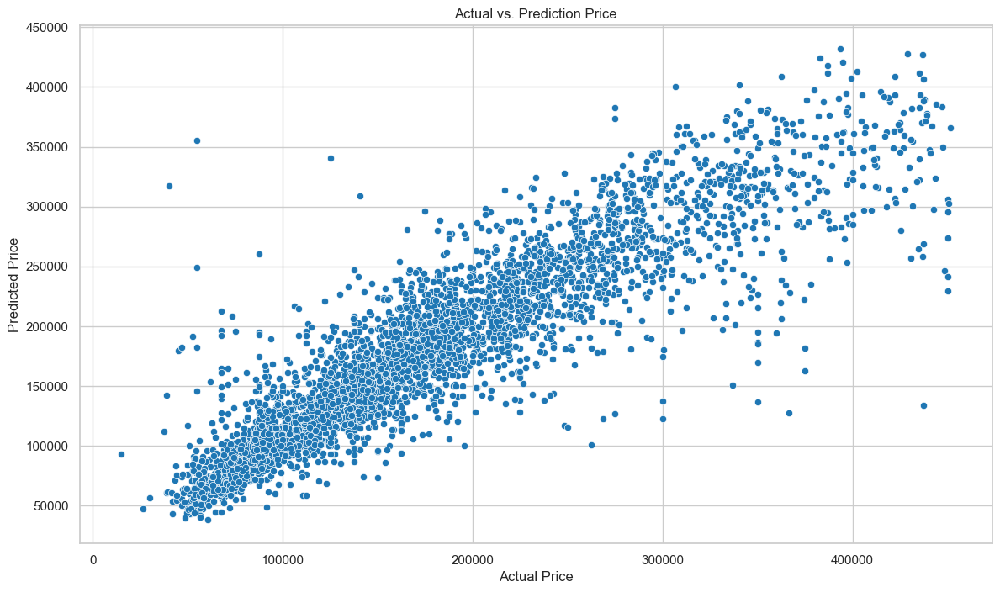

In [ ]:
plt.figure(figsize=(14, 8))
plot = sns.scatterplot(x=y_test, y=y_pred_xgb_tuning).set(title='Actual vs. Prediction Price', 
                                               xlabel='Actual Price', 
                                               ylabel='Predicted Price')

__Insight:__

Dari plot di atas, terlihat bahwa masih terdapat cukup banyak bias antara harga aktual dan prediksi. Meskipun model XGBoost setelah hyperparameter tuning telah menunjukkan peningkatan dalam performa prediksinya, masih terlihat bahwa sebagian besar titik-titik data berada di atas garis diagonal. Semakin naik nilai `median_house_value`, semakin bias juga nilai antara prediksi dan aktualnya, sebagaimana tergambar pada visualisasi. Hal ini mengindikasikan bahwa model cenderung melakukan underestimasi terhadap harga properti yang memiliki nilai `median_house_value` tinggi, yang dapat dilihat dari jarak antara titik-titik tersebut dengan garis diagonal. Meskipun demikian, perbaikan yang telah dicapai melalui proses hyperparameter tuning tetap memberikan hasil prediksi yang lebih mendekati nilai aktual secara keseluruhan.

**Model Intepretation**

**Feature Importances**

menunjukkan tingkat pentingnya masing-masing fitur dalam model XGBoost yang telah mengalami penyetelan hiperparameter. 

Text(0, 0.5, 'Fitur')

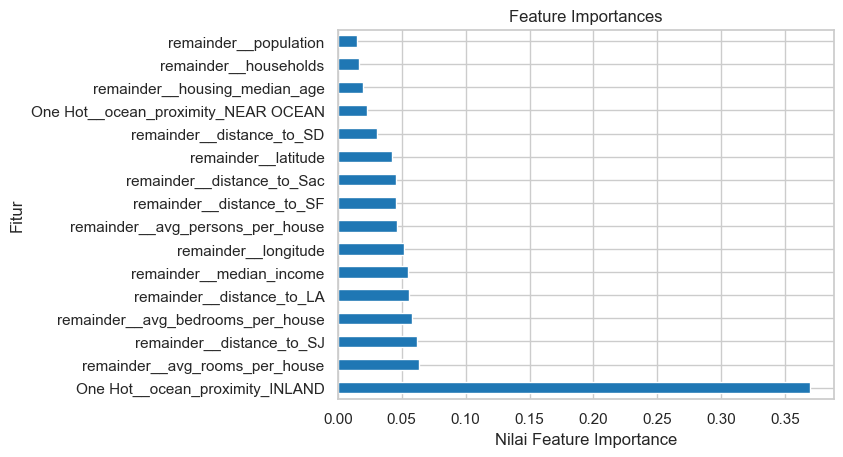

In [ ]:
# Mendapatkan feature importances dari model XGBoost
feature_imp = pd.Series(xgb_tuning['model'].feature_importances_)

# Dapatkan daftar nama fitur setelah transformasi dari objek transformer
transformed_feature_names = transformer.get_feature_names_out(input_features=X_train.columns)

# Mengaitkan daftar nama fitur dengan feature_importances_
feature_imp.index = transformed_feature_names

# Menampilkan feature importances dalam bentuk bar plot
feature_imp_sorted = feature_imp.sort_values(ascending=False)  
feature_imp_sorted.plot(kind='barh', title='Feature Importances')  
plt.xlabel('Nilai Feature Importance') 
plt.ylabel('Fitur')  


__Insight:__

Dari plot yang diberikan, terlihat bahwa beberapa fitur memiliki pengaruh yang signifikan terhadap nilai median_house_value (harga rumah median). Fitur-fitur tersebut adalah:

1. **Ocean Proximity:** Fitur ini tampak memiliki pengaruh yang besar terhadap harga rumah. Ini menunjukkan bahwa lokasi rumah berhubungan erat dengan harga rumah. Rumah yang berlokasi di pinggir laut atau memiliki akses yang baik ke laut cenderung memiliki harga yang lebih tinggi daripada rumah yang berlokasi di dalam daratan.

2. **Avg Rooms Per House:** Fitur ini juga memiliki dampak yang cukup besar. Rata-rata jumlah ruangan per rumah (avg_rooms_per_house) dapat memberikan gambaran tentang ukuran dan jenis properti. Properti yang lebih besar atau memiliki lebih banyak ruangan cenderung memiliki harga yang lebih tinggi.

3. **Distance to San Jose (Distance_to_SJ):** Jarak rumah ke San Jose juga mempengaruhi nilai median rumah. Ini menunjukkan bahwa properti yang lebih dekat dengan pusat kota atau pusat kegiatan ekonomi cenderung memiliki harga yang lebih tinggi.

4. **Avg Bedrooms Per House:** Rata-rata jumlah kamar tidur per rumah (avg_bedrooms_per_house) juga memainkan peran penting. Properti dengan lebih banyak kamar tidur atau kamar tidur yang lebih besar dapat memiliki harga yang lebih tinggi.

Pemahaman ini mengindikasikan bahwa faktor-faktor seperti lokasi, ukuran properti (jumlah ruangan dan kamar tidur), serta jarak ke pusat kegiatan ekonomi sangat berkontribusi dalam menentukan harga median rumah. Oleh karena itu, saat melakukan prediksi atau analisis harga rumah di California, penting untuk mempertimbangkan dan mungkin juga menambahkan fitur-fitur ini agar model dapat memberikan estimasi yang lebih akurat dan dapat diinterpretasikan.

**Model Limitation**

**Residual**

Perbedaan antara nilai aktual target (observasi) dan nilai yang diprediksi oleh model. 

In [ ]:
# Residual = y_actual - y_prediksi
residual = y_test-y_pred_xgb_tuning

df_residual = pd.DataFrame({
    'y_pred': y_pred_xgb_tuning,
    'residual': residual 
})

df_residual.head()

,y_pred,residual
9274,192472.000000,-31372.000000
2604,229034.046875,-50734.046875
14126,235756.484375,-47356.484375
7490,239155.062500,-66955.062500
14416,185426.656250,1573.343750


__Insight:__
* Pada baris terakhir yang memiliki prediksi 185,427 dan aktual 185,426. Ini menunjukkan bahwa prediksi sedikit melebihi nilai aktual. Namun, pada beberapa baris lain, terdapat residual negatif yang menunjukkan bahwa prediksi di bawah nilai aktual.
* Jumlah residual bervariasi dari -66,955 hingga +1,573, menunjukkan adanya variasi dalam performa prediksi pada beberapa kasus. Ada prediksi yang cukup akurat (residual mendekati nol), tetapi ada juga prediksi yang memiliki selisih yang lebih besar dari nilai aktual.

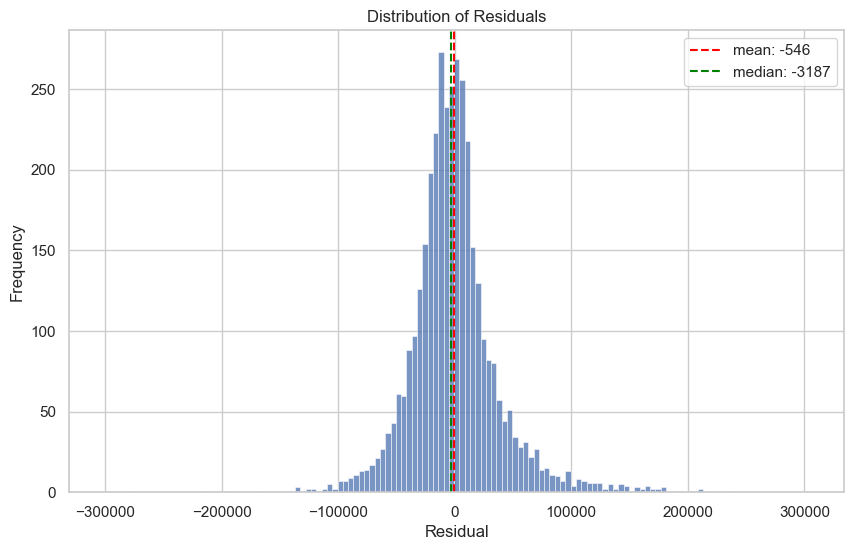

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create the histogram
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
ax1 = sns.histplot(data=df_residual, x='residual')

# Add vertical lines for mean and median
ax1.axvline(x=df_residual['residual'].mean(), color='red', label=f"mean: {round(df_residual['residual'].mean())}", linestyle='--')
ax1.axvline(x=df_residual['residual'].median(), color='green', label=f"median: {round(df_residual['residual'].median())}", linestyle='--')

# Add labels and legend
plt.xlabel('Residual')
plt.ylabel('Frequency')
plt.title('Distribution of Residuals')
plt.legend()

# Show the plot
plt.show()


In [ ]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df_residual)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


__insight:__

Dari plot distribusi residual di atas, terlihat bahwa sebagian besar residual berpusat di sekitar nilai negatif yang mendekati nol, dengan sedikit perbedaan antara mean dan median residual. Terdapat sejumlah kecil data dengan residual yang lebih rendah dari nilai median, yang menunjukkan bahwa model cenderung menghasilkan prediksi yang terlalu rendah untuk data-data tersebut. Nilai mean residual sebesar -546 dan median residual sebesar -3187 mengindikasikan bahwa secara rata-rata, prediksi model cenderung kurang dari harga aktual sekitar $546, sedangkan nilai tengahnya (median) lebih rendah lagi, yaitu sekitar $3187. Dengan demikian, model memiliki kecenderungan untuk melakukan underestimation terhadap harga rumah.

**Diharapkan**: \
Distribusi residual adalah berpusat di titik median, yang artinya nilai rata-rata residual adalah 0. Residual adalah selisih antara nilai aktual dan nilai prediksi dari model. Jika model prediksi akurat, maka seharusnya nilai residual mendekati nol.\
Namun, dalam praktiknya, sulit untuk mencapai nilai residual yang persis nol karena ada berbagai faktor yang dapat mempengaruhi ketidaksempurnaan model, seperti noise dalam data, kompleksitas model, dan ketidakakuratan prediksi. Oleh karena itu, distribusi residual sering kali memiliki beberapa variasi dan bias dari nilai nol.

**Ekspetasi**:\
Terlihat bahwa distribusi residual cenderung berpusat di sekitar nilai negatif yang mendekati nol, tetapi belum mencapai nilai nol. Ini menunjukkan bahwa model masih memiliki bias tertentu dalam prediksinya dan ada ruang untuk peningkatan kualitas prediksi untuk mendekati nilai residual yang ideal yaitu nol.

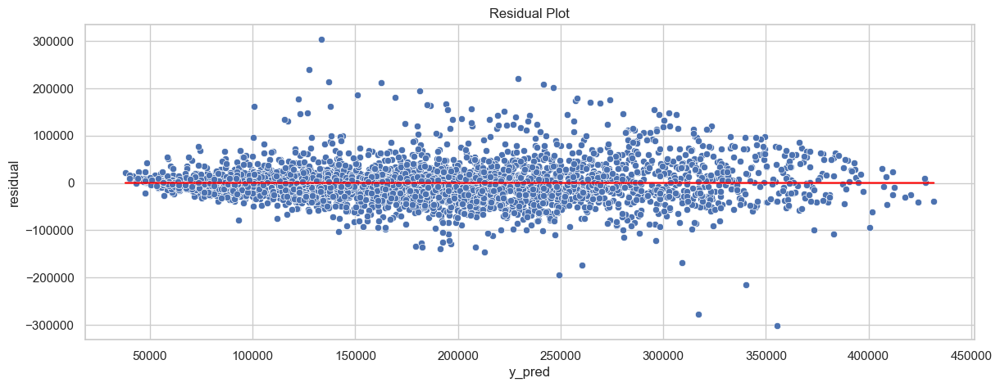

In [ ]:
# Residual Plot

plt.figure(figsize=(14,5))
sns.scatterplot(data=df_residual, x='y_pred', y='residual')
sns.lineplot(data=df_residual, x='y_pred', y=0, color='red')
plt.title('Residual Plot')
plt.show()

__Insight:__

Ada beberapa data yang memiliki nilai error yang cukup besar, namun jumlahnya tidak terlalu banyak. Dalam visualisasi di atas, terlihat beberapa kasus di mana harga aktual rendah namun diprediksi lebih tinggi (overestimation), dan sebaliknya (underestimation). Meskipun demikian, perbedaan harga ini tidak begitu signifikan, dan sebagian besar prediksi harga sudah cukup mendekati harga aktual. Dengan nilai MAPE sekitar 16%, model ini dapat dianggap sebagai 'reasonable forecasting' atau prediksi yang masuk akal.

Ketika nilai prediksi membesar, error semakin menyebar luas. Hal ini menandakan dilanggarnya asumsi kehomogenan ragam. Namun, pada rentang nilai prediksi antara 200,000 hingga 250,000, error mulai menurun. Hal ini mengindikasikan bahwa pada rentang tersebut, asumsi kehomogenan ragam mungkin lebih mendekati terpenuhi.


In [ ]:
data.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,14448.000000,14448.000000,14448.000000,14448.000000,14311.000000,14448.000000,14448.000000,14448.000000,14448.000000
mean,-119.566647,35.630093,28.618702,2640.132683,538.260709,1425.157323,499.508929,3.866667,206824.624516
std,2.006587,2.140121,12.596694,2191.612441,423.577544,1149.580157,383.098390,1.891158,115365.476182
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1451.000000,295.000000,784.000000,279.000000,2.570600,119600.000000
50%,-118.490000,34.260000,29.000000,2125.000000,435.000000,1165.000000,410.000000,3.539100,180000.000000
75%,-118.000000,37.710000,37.000000,3148.000000,647.000000,1724.000000,604.000000,4.736100,263900.000000
max,-114.310000,41.950000,52.000000,32627.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


__Insight:__

Model prediksi harga perumahan ini memiliki beberapa batasan yang perlu dipahami. Pertama, model tidak dapat memberikan prediksi yang akurat untuk properti dengan harga di atas 500.000 USD. Ini berarti bahwa jika Anda mencoba memprediksi nilai properti yang lebih tinggi dari batas ini, hasil prediksinya mungkin tidak akurat dan dapat menghasilkan estimasi yang tidak sesuai dengan kenyataan.

Selain itu, penting untuk mengingat bahwa model ini telah dioptimalkan khusus untuk melakukan prediksi pada jenis properti perumahan. Ini berarti bahwa model ini telah mempelajari pola dan karakteristik tertentu dari data pelatihan yang berkaitan dengan perumahan. Oleh karena itu, ketika digunakan untuk memprediksi properti lain seperti apartemen atau condominium, model mungkin tidak memiliki pemahaman yang cukup tentang karakteristik unik dari jenis properti tersebut. Akibatnya, prediksi untuk jenis properti yang berbeda mungkin tidak akurat dan dapat menghasilkan hasil yang tidak sesuai harapan.

Penting untuk selalu mempertimbangkan batasan-batasan ini ketika menggunakan model prediksi ini. Model ini paling cocok digunakan untuk memprediksi harga perumahan dalam rentang harga yang sesuai dan untuk jenis properti yang telah dioptimalkan dalam proses pelatihan. Jika Anda memiliki kebutuhan untuk memprediksi properti di luar batasan ini atau untuk jenis properti yang berbeda, mungkin diperlukan pendekatan atau model yang berbeda yang dapat mempertimbangkan karakteristik yang lebih luas.

### `Conclusion`

Beberapa hal yang dapat disimpulkan yaitu:

* Berdasarkan pemodelan yang sudah dilakukan, fitur ocean_proximity memilki pengaruh paling tinggi terhadap median_house_value. Karena Hal tersebut dapat dianggap sebagai hasil yang masuk akal, yang menunjukkan bahwa faktor lokasi memang memiliki peran yang sangat signifikan dalam memprediksi harga rumah. Semakin eksklusif atau prestisius suatu lokasi, cenderung akan memberikan dampak positif terhadap harga rumah.  Sebaliknya, lokasi yang kurang strategis mungkin akan memiliki harga yang lebih rendah. Hal tersebut juga didukung dengan fitur distance yang berpengaruh terhadap median_house_value.Dalam skenario ini, terlihat bahwa properti yang terletak di daerah tepi dengan pemandangan laut memiliki harga yang lebih tinggi dibandingkan dengan properti di lokasi lain. Tetapi avg bedrooms dan rooms, dan median_income juga menjadi fitur yang memberikan pengaruh terhadap median_value_house.

* Metrik evaluasi yang digunakan pada model adalah nilai RMSE, MAE & MAPE.

* Algoritma untuk melakukan cross validation : LinearRegression, KNN Regressor, DecisionTreeRegressor, RandomForestRegressor, dan XGBoost Regressor.

* Model yang dipilih adalah XGBoost Regressor dilihat dari hasil cross validation MAPE, dikarenakan mempunyai error yang paling kecil berupa 16.9% sebelum tuning dan 16.8% setelah tuning.

* Karena data masih tergolong memilki cukup banyak outlier dan jika dihilangkan maka akan kehilangan banyak informasi, sehingga menggunakan MAPE yang tidak terlalu sensitive terhadap adanya outlier. Jika ditinjau dari nilai MAPE yang dihasilkan oleh model setelah dilakukan hyperparameter tuning, yaitu sebesar 16%, kita dapat menyimpulkan bahwa bila nanti model yang kita buat ini digunakan untuk memperkirakan harga rumah baru di California pada rentang nilai seperti yang dilatih terhadap model, maka perkiraan harganya rata-rata akan meleset kurang lebih sebesar 16% dari harga seharusnya. Selain itu nilai MAPE 16% artinya termasuk kedalam kategory 'Good Forecast' atau model peramalan baik.

* Tidak menutup kemungkinan juga prediksinya meleset lebih jauh karena bias yang dihasilkan model masih cukup tinggi bila dilihat dari visualisasi antara harga aktual dan prediksi. Bias yang dihasilkan oleh model ini dikarenakan oleh terbatasnya fitur pada dataset yang bisa merepresentasikan aspek properti seperti luas tanah, luas bangunan, fasilitas rumah, daerah perumahan, dan akses transportasi.

* Model prediksi harga perumahan ini memiliki beberapa batasan yang perlu dipahami. Pertama, model tidak dapat memberikan prediksi yang akurat untuk properti dengan harga di atas 500.000 USD. Ini berarti bahwa jika Anda mencoba memprediksi nilai properti yang lebih tinggi dari batas ini, hasil prediksinya mungkin tidak akurat dan dapat menghasilkan estimasi yang tidak sesuai dengan kenyataan.

### `Recommendations`

Hal yang dapat dilakukan untuk mengembangkan model agar lebih baik lagi, seperti:

* Meningkatkan korelasi dengan target dapat dilakukan dengan memasukkan fitur seperti luas bangunan, fasilitas parkir mobil, halaman rumah, dan kolam renang. Selain itu, eksplorasi lebih lanjut terhadap variabel terkait fasilitas di sekitar properti juga berpotensi memberikan dampak yang signifikan pada prediksi harga rumah. Penggunaan data terkini tentang harga rumah di California juga berpotensi meningkatkan kapasitas prediksi model.

* Melakukan penambahan data seperti harga jual rumah secara berkala dengan interval waktu tertentu bertujuan untuk mengumpulkan data terbaru yang melibatkan beragam variabel yang berpotensi memiliki hubungan dengan harga rumah. Proses ini memberikan pembaruan informasi terkini tentang tren pasar perumahan dan faktor-faktor yang mempengaruhi nilai properti. Dengan mengumpulkan data yang lebih lengkap dan relevan, termasuk variabel yang memiliki potensi korelasi dengan harga rumah, kita dapat meningkatkan pemahaman tentang dinamika pasar dan faktor-faktor penting yang memengaruhi fluktuasi harga properti. Hal ini membantu dalam menginformasikan keputusan bisnis dan strategi di sektor real estate, serta memastikan bahwa model prediksi harga rumah tetap relevan dan akurat dalam menghadapi perubahan lingkungan pasar yang terus berlangsung.

* Penting untuk memperbarui data karena dataset yang digunakan berasal dari tahun 1990 dan tidak lagi relevan dengan kondisi saat ini, terutama mengingat adanya faktor inflasi dan perubahan pasar seiring waktu. Model prediksi ini memiliki kemampuan untuk memproyeksikan harga perumahan dengan fitur serupa dengan dataset California house. Analisis perbandingan antara nilai training dan testing mengindikasikan bahwa model ini menunjukkan kinerja yang stabil dan menghindari masalah overfitting atau underfitting. Namun, perlu diingat bahwa data tahun 1990 tidak mencerminkan harga perumahan saat ini, dan oleh karena itu, perlu hati-hati dalam menginterpretasikan hasil prediksi, terutama jika range harga yang diprediksi berada di luar jangkauan harga yang telah dipelajari oleh model.

### Save Model

In [ ]:
# # Import library
# import _pickle as pickle

# # Save model
# estimator = Pipeline([
#         ('preprocessing', transformer), ('model', RandomForestRegressor())])
# estimator.fit(X_train,y_train)

# pickle.dump(estimator, open('data_california_house.sav', 'wb'))

# # Load model
# pickle_capstone3 = 'data_california_house.sav'

# loaded_model = pickle.load(open(pickle_capstone3, 'rb'))

In [ ]:
# np.sqrt(mean_squared_error(y_test, loaded_model.predict(X_test)))